### Clone repository

In [1]:
! git clone https://github.com/RufinaMay/MedicalReports_v1.git
!mv /content/MedicalReports_v1/* /content/

Cloning into 'MedicalReports_v1'...
remote: Enumerating objects: 187, done.
remote: Counting objects: 100% (187/187), done.
remote: Compressing objects: 100% (121/121), done.
remote: Total 1029 (delta 89), reused 124 (delta 43), pack-reused 842
Receiving objects: 100% (1029/1029), 50.57 MiB | 31.98 MiB/s, done.
Resolving deltas: 100% (551/551), done.


### Download data

In [0]:
from IPython.display import clear_output
import warnings
warnings.filterwarnings('ignore')
!wget https://openi.nlm.nih.gov/imgs/collections/NLMCXR_png.tgz -O images.tgz
!wget https://openi.nlm.nih.gov/imgs/collections/NLMCXR_reports.tgz -O reports.tgz
clear_output()

from preprocessing.chest_xray_extractor import unzip
unzip('images.tgz', 'data/chest_images')
unzip('reports.tgz', 'data/chest_reports')

### Process reports (Run only if you want to create your own data split)

Extract labels for multilabel classification, extract reports texts, create image-tag mapping

In [3]:
from preprocessing.chest_xray_extractor import process_all_reports

IMG_REPORT, IMG_TAG, TAG_VOCAB, WORD_VOCAB, TAG_IMAGESNUMB = process_all_reports('data/chest_reports/ecgen-radiology')

total image tag pairs 7470


### Split on train test and validation sets (Run only if you want to create your own data split)

     |████████████████████████████████| 92kB 4.0MB/s 
total samples 7470
train samples 4678
valid samples 888
test samples 1904


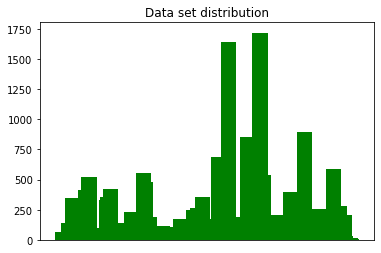

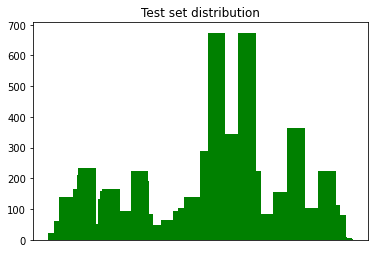

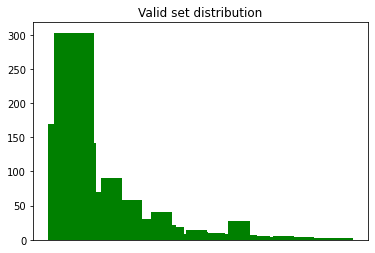

In [4]:
!pip install scikit-multilearn
from preprocessing.train_test_split import run_split

_ = run_split(save=True, draw_distrib=True)

### Load all data in memory

In [0]:
import pickle

from utils.utils import apply_hierarchy
from utils.constants import PATH_IMG_TAG_MAPPING, PATH_TAG_TO_INDEX

with open(PATH_IMG_TAG_MAPPING, 'rb') as f:
  IMG_TAG_MAPPING = pickle.load(f) 

with open(PATH_TAG_TO_INDEX, 'rb') as f:
  tag_to_index = pickle.load(f)
tag_to_index['start'] = len(tag_to_index)
tag_to_index['end'] = len(tag_to_index)
tag_to_index['pad'] = len(tag_to_index)
UNIQUE_TAGS = len(tag_to_index)
print(f'number of unique tags {UNIQUE_TAGS}')

with open('train_set.pickle', 'rb') as f:
    train_set = pickle.load(f)
with open('valid_set.pickle', 'rb') as f:
    valid_set = pickle.load(f)
with open('test_set.pickle', 'rb') as f:
    test_set = pickle.load(f)

train_set, valid_set, test_set = apply_hierarchy(train_set, valid_set, test_set)

# DEFINE A MAPPING FROM ENCODER TO ENCODER DIMENTIONS
encoder_encoderdim_mapping = {'densenet': 1024,'shufflenet':192, 'resnet': 2048, 'vgg':512, 'googlenet':1024, 'mnasnet':1280, 'resnext':2048}

number of unique tags 131


### Define attention LSTM model's parts

The following encoders are availbale: densenet, shufflenet, resnet, vgg, googlenet, mnasnet. You should specify the one that you want to use in *ENCODER_NAME* variable.

In [0]:
import torch
from torch import nn

from utils.constants import epochs, encoder_lr, decoder_lr, alpha_c, emb_dim, attention_dim, decoder_dim, dropout
from models.mlc.attention_LSTM import Encoder, DecoderWithAttention, Attention

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 
# HOW TO USE DOFFERENT KINDS OF ENCODERS
encoder_encoderdim_mapping = {'densenet': 1024,'shufflenet':192, 'resnet': 2048, 'vgg':512, 'googlenet':1024, 'mnasnet':1280}

ENCODER_NAME = 'densenet'
decoder = DecoderWithAttention(attention_dim=attention_dim,
                                embed_dim=emb_dim,
                                decoder_dim=decoder_dim,
                                vocab_size=UNIQUE_TAGS,
                                 encoder_dim = encoder_encoderdim_mapping[ENCODER_NAME],
                                dropout=dropout)
decoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, decoder.parameters()), lr=decoder_lr)
encoder = Encoder(encoder_name=ENCODER_NAME)
encoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, encoder.parameters()), lr=encoder_lr)

decoder = decoder.to(device)
encoder = encoder.to(device)
criterion = nn.CrossEntropyLoss().to(device)

### Train Attention LSTM

Training take from 2 to 5 hours depending on the encoder used. Final encoder that we use in *DenseNet* that takes 5 hours to train.

In [0]:
from utils.utils import f1_score, eval, process_predictions
from models.mlc.attention_LSTM import train_step, train_epoch, train

train_metrics,valid_metrics, test_metrics, encoder, decoder = train(0, epochs, train_set, valid_set, test_set, tag_to_index, UNIQUE_TAGS, 
                     encoder, decoder, decoder_optimizer, encoder_optimizer, criterion, device, include_negatives=True, verbose=False)

### Save model and results

In [0]:
from utils.utils import save_models, save_metrics

save_models(ENCODER_NAME, True, encoder, decoder)
save_metrics(ENCODER_NAME, True, train_metrics, valid_metrics, test_metrics)

### Plot training vs Validation loss

In [0]:
from matplotlib import pyplot as plt

valid_metrics = valid_metrics.reshape(valid_metrics.shape[0], -1)
train_metrics = train_metrics.reshape(train_metrics.shape[0], -1)
plt.plot(valid_metrics[:,0], label = 'val')
plt.plot(train_metrics[:,0], label = 'tra')
plt.title('Loss')
plt.legend()
plt.show()

### Visualize attention weights

In [0]:
from models.mlc.attention_LSTM import visualize_attention

visualize_attention(tag_to_index, test_set, UNIQUE_TAGS, encoder, decoder, device)

### Analize mistakes

In [0]:
from utils.utils import analyze_mistakes
from models.mlc.attention_LSTM import prediction

true, predicted, pred_scores = prediction(encoder, decoder, device, test_set, tag_to_index, UNIQUE_TAGS)
_ = analyze_mistakes(true, predicted, pred_scores, train_set, tag_to_index, make_plots=True)

# Big experiments section on LSTM with Attention

Here we are conducting all the experiments, e.g. with all possible encoders, negative sampling, non negative sampling and save the result

Time to train: for densenet 5 hours

DECAYING learning rate.
The new learning rate is 0.000320


DECAYING learning rate.
The new learning rate is 0.000160


DECAYING learning rate.
The new learning rate is 0.000256


DECAYING learning rate.
The new learning rate is 0.000128


DECAYING learning rate.
The new learning rate is 0.000205


DECAYING learning rate.
The new learning rate is 0.000102


DECAYING learning rate.
The new learning rate is 0.000164


DECAYING learning rate.
The new learning rate is 0.000082


DECAYING learning rate.
The new learning rate is 0.000131


DECAYING learning rate.
The new learning rate is 0.000066


Model name: Attention LSTM with densenet and negative sampling
Test set performance
Precision 0.47731371618414805 Recall 0.47731371618414805 Overall Precision 0.36876358662300737 Overall Recall 0.36876358662300737 Macro F1 0.114047350972073205
Micro F1 0.4642194479441072 Instance F1 0.50651513254040195 Hamming loss 0.04577011873350924 AUC 0.7828144971100198
Training time 18562.52610373497


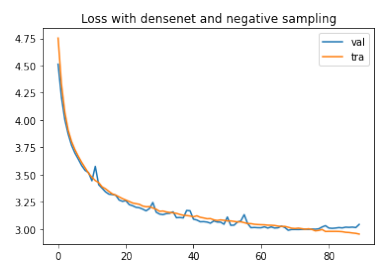

10 best predictions of the model


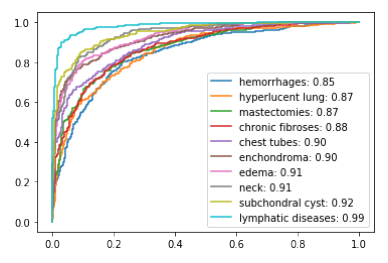

10 worst predictions of the model


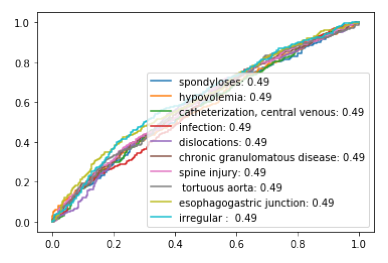

Score vs Number of samples


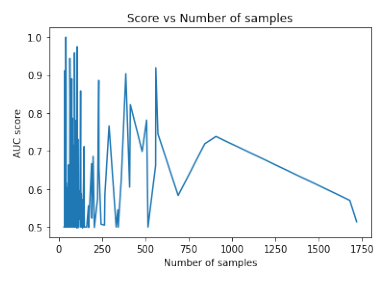

torch.Size([2, 14, 14])


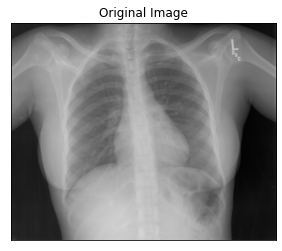

True ['degenerative change']
Predictions ['degenerative change']


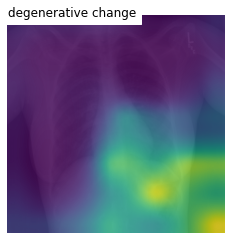

torch.Size([10, 14, 14])


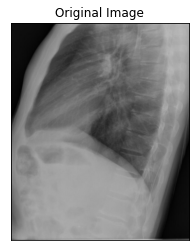

True ['splenic calcification', 'pulmonary sarcoidoses', 'catheterization, central venous', 'surgery']
Predictions ['splenic calcification', 'arthroplasty, replacement', 'degenerative change', 'surgery']


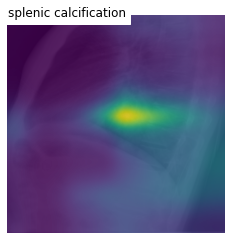

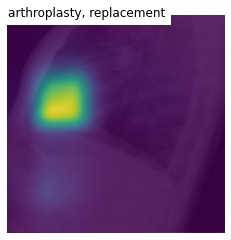

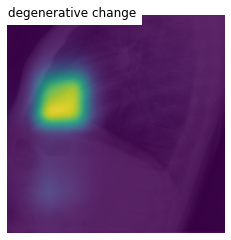

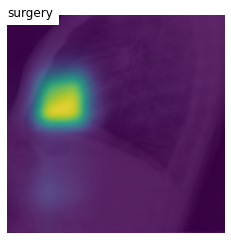

torch.Size([15, 14, 14])


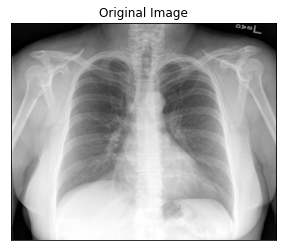

True ['splenic calcification', 'pulmonary sarcoidoses', 'catheterization, central venous', 'surgery']
Predictions ['splenic calcification', 'arthroplasty, replacement', 'degenerative change', 'surgery']


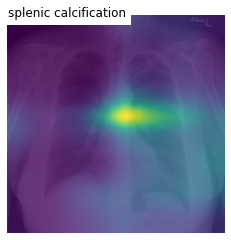

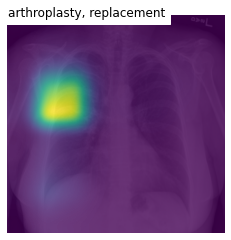

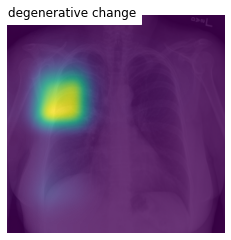

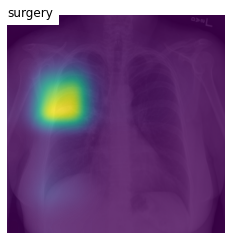

torch.Size([40, 14, 14])


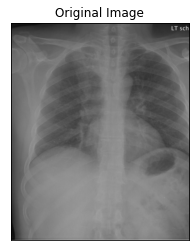

True ['nephrostomy', 'splenic calcification', 'pulmonary sarcoidoses', 'patchy', 'esophagectomy', 'chronic fibroses', 'surgery', 'nodule']
Predictions ['arthroplasty, replacement', 'kyphoses', 'degenerative change', 'chronic fibroses', 'surgery', 'nodule']


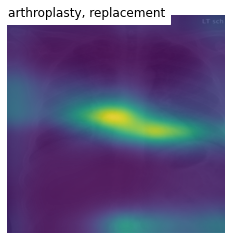

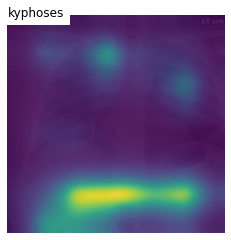

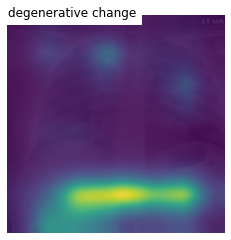

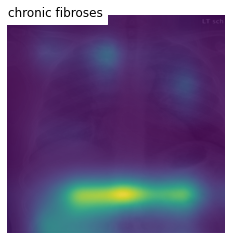

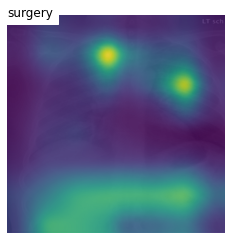

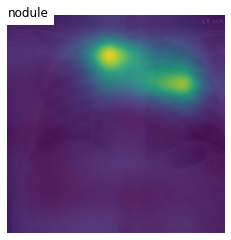

torch.Size([50, 14, 14])


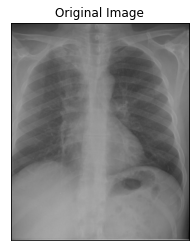

True ['nephrostomy', 'splenic calcification', 'pulmonary sarcoidoses', 'patchy', 'esophagectomy', 'chronic fibroses', 'surgery', 'nodule']
Predictions ['kyphoses', 'degenerative change', 'chronic fibroses', 'surgery', 'nodule', 'interstitial']


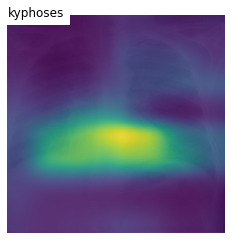

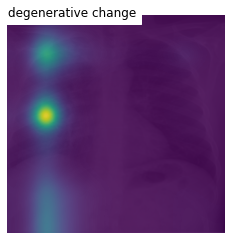

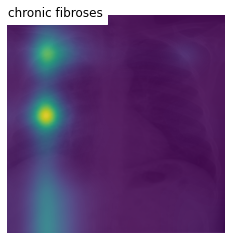

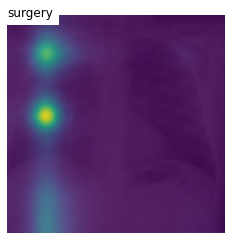

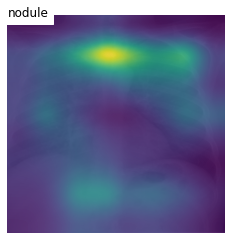

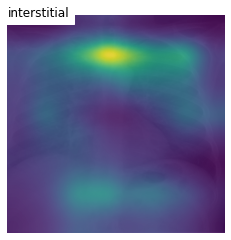

torch.Size([60, 14, 14])


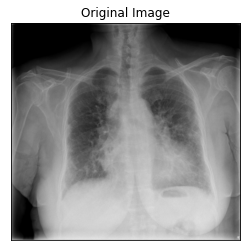

True ['nephrostomy', 'splenic calcification', 'pulmonary sarcoidoses', 'patchy', 'esophagectomy', 'chronic fibroses', 'surgery', 'nodule']
Predictions ['arthroplasty, replacement', 'kyphoses', 'degenerative change', 'chronic fibroses', 'surgery', 'nodule']


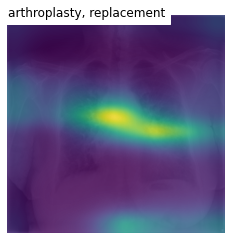

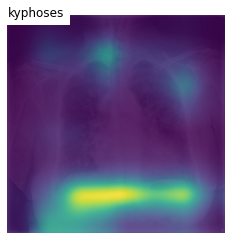

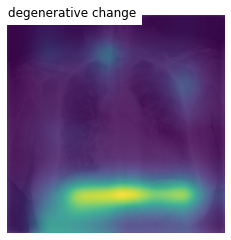

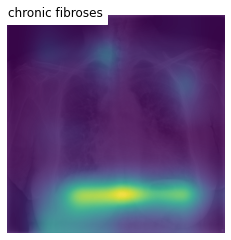

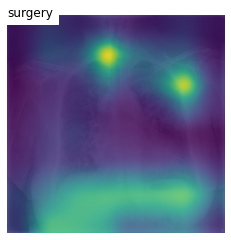

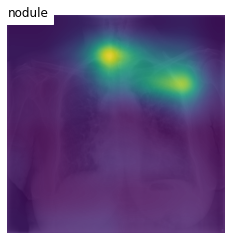

torch.Size([112, 14, 14])


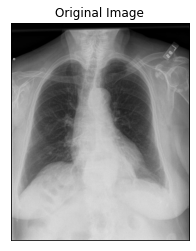

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


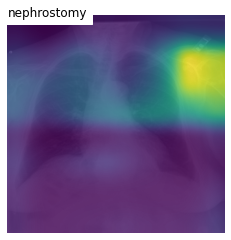

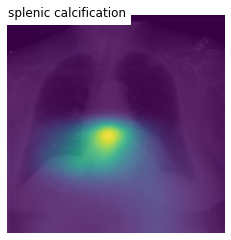

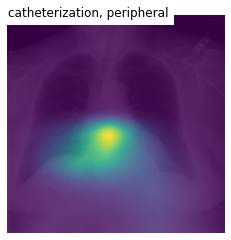

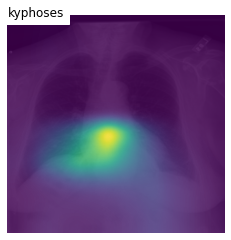

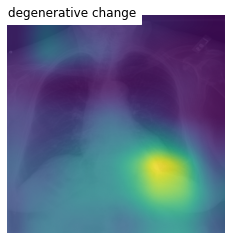

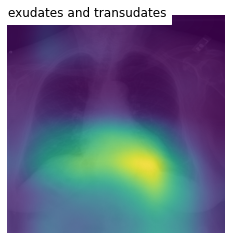

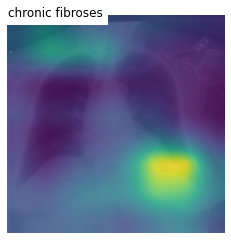

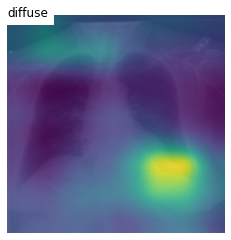

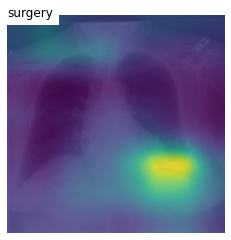

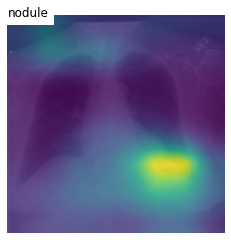

torch.Size([128, 14, 14])


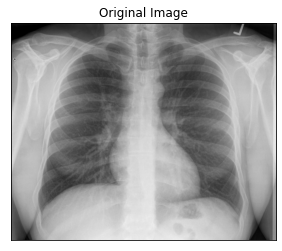

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


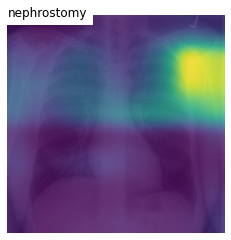

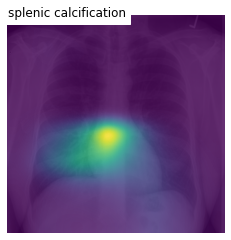

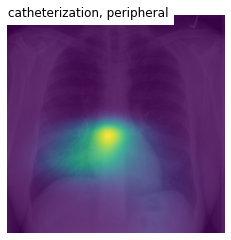

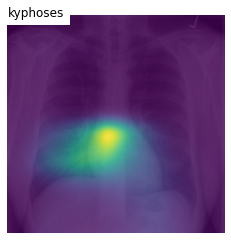

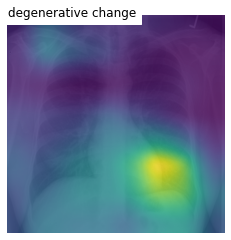

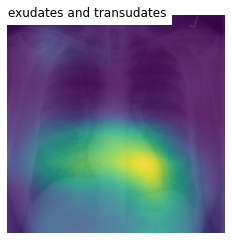

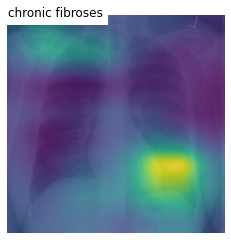

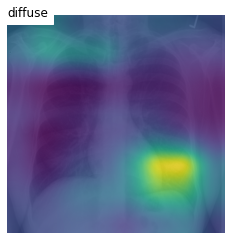

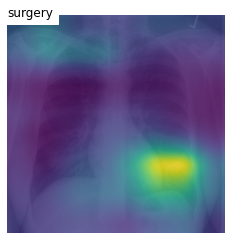

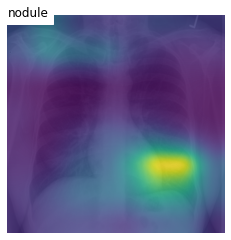

torch.Size([144, 14, 14])


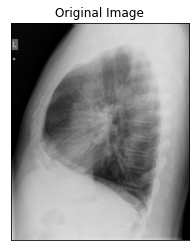

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


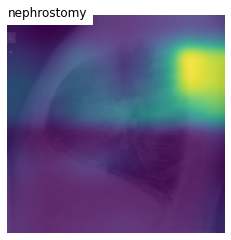

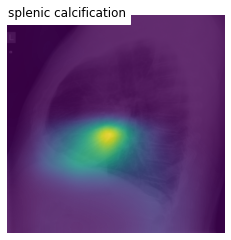

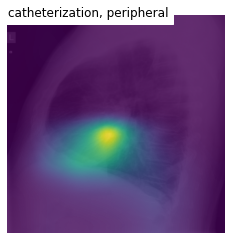

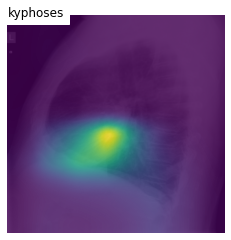

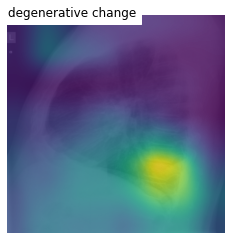

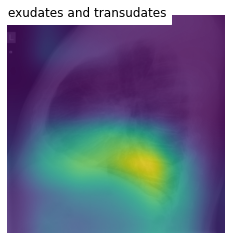

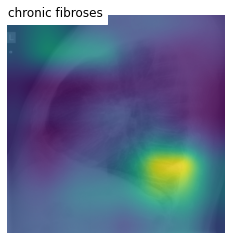

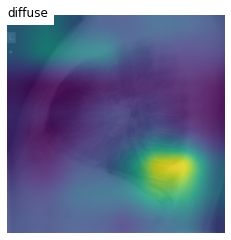

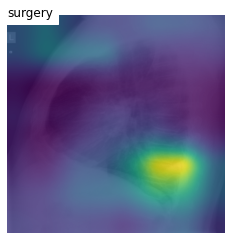

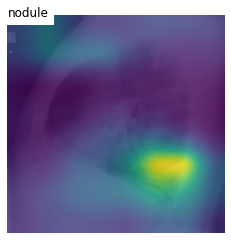

torch.Size([160, 14, 14])


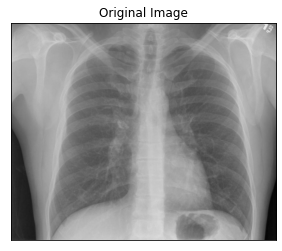

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


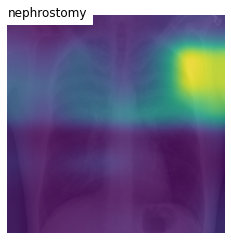

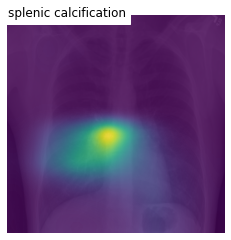

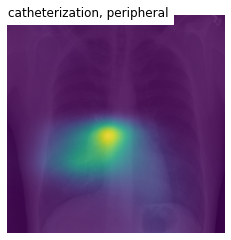

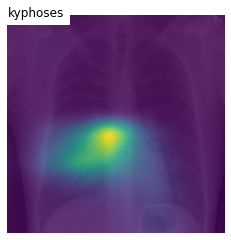

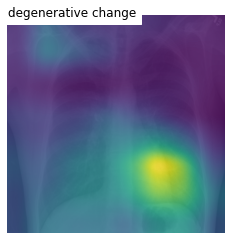

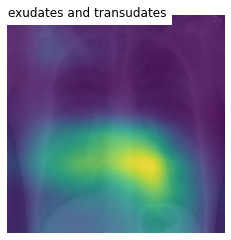

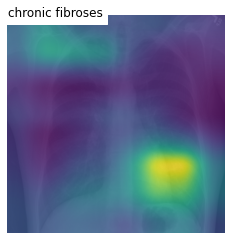

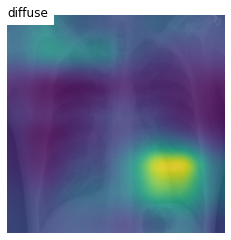

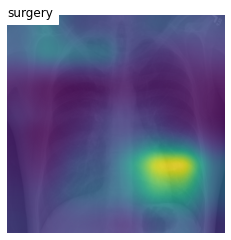

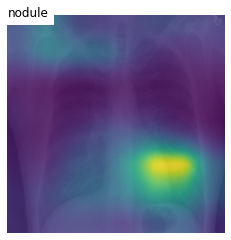

torch.Size([176, 14, 14])


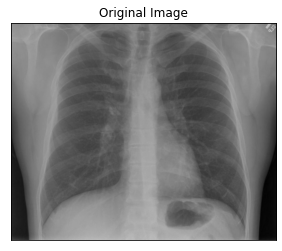

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


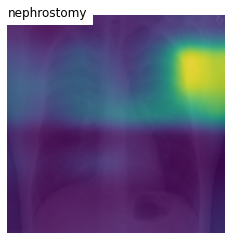

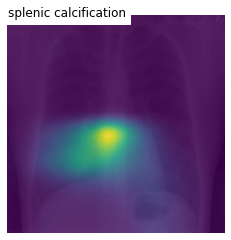

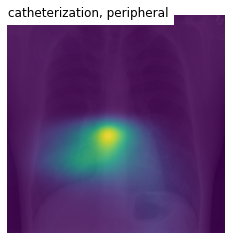

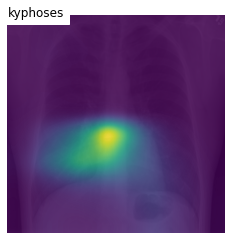

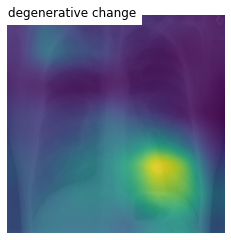

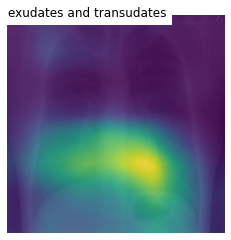

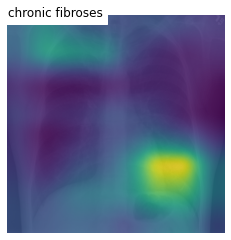

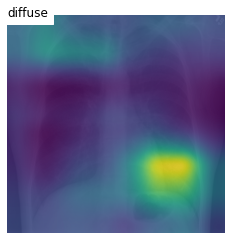

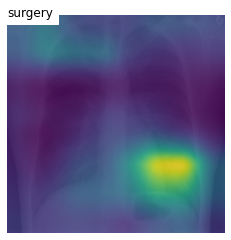

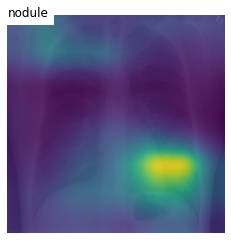

torch.Size([192, 14, 14])


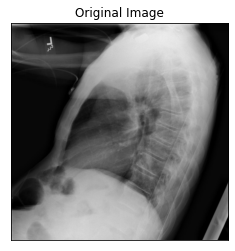

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


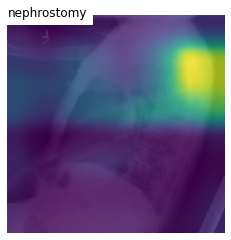

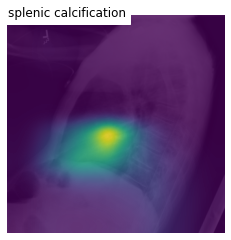

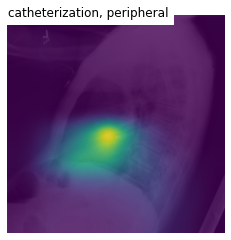

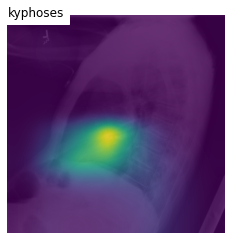

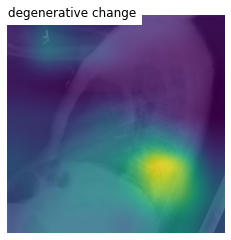

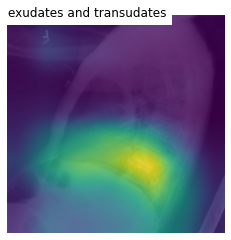

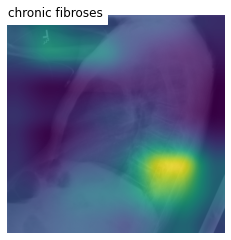

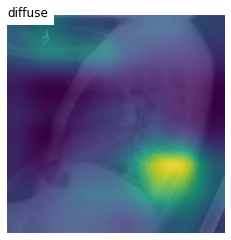

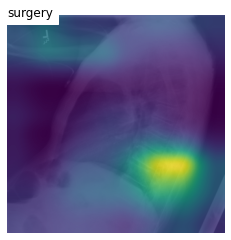

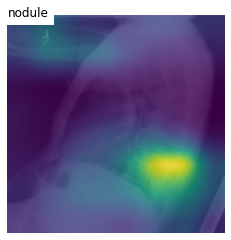

torch.Size([208, 14, 14])


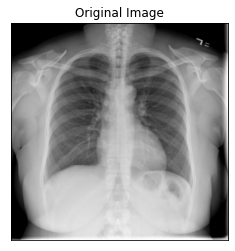

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


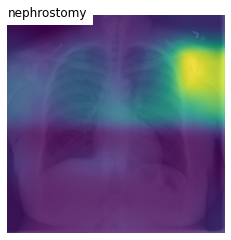

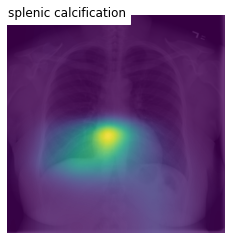

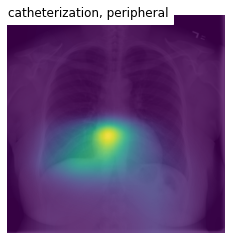

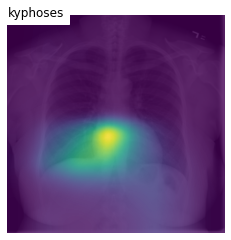

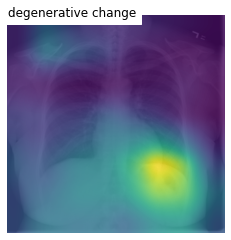

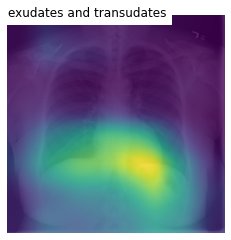

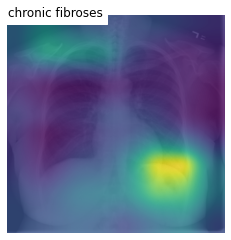

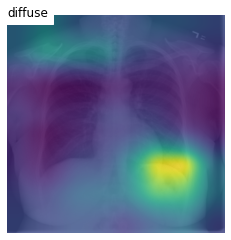

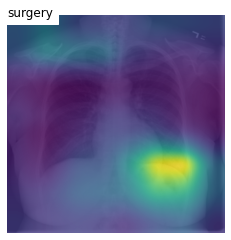

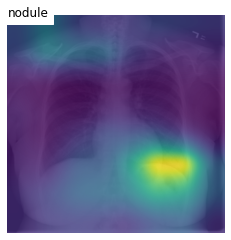

torch.Size([224, 14, 14])


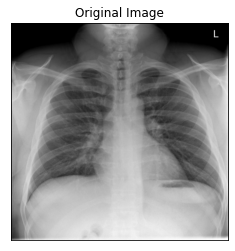

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


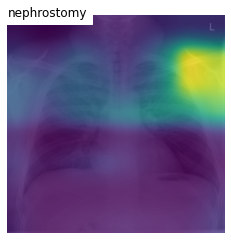

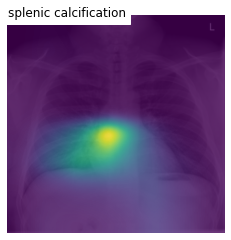

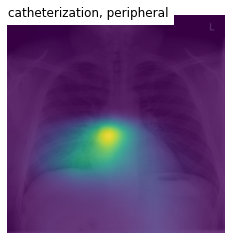

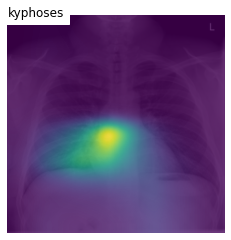

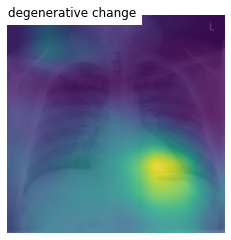

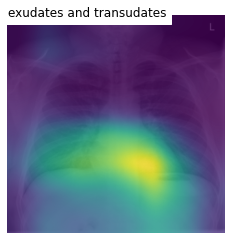

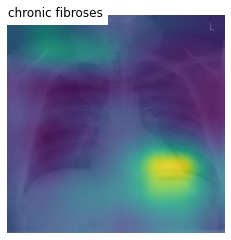

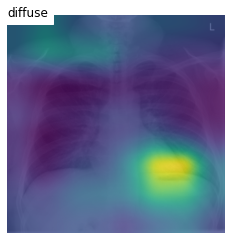

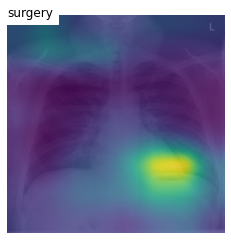

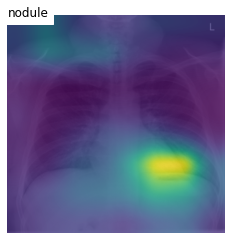

torch.Size([240, 14, 14])


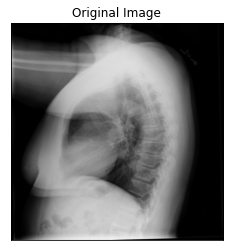

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


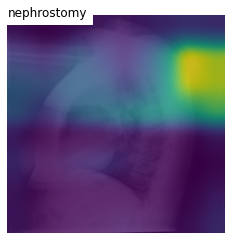

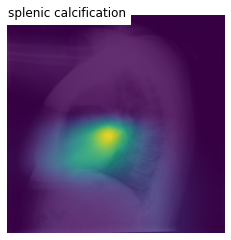

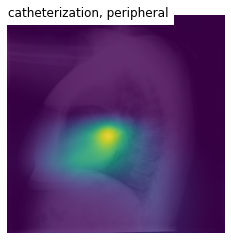

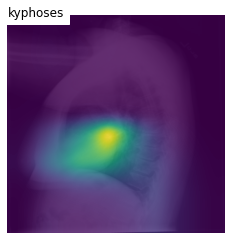

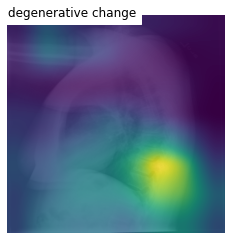

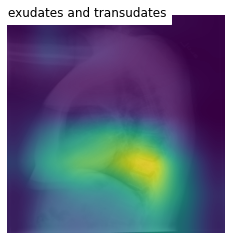

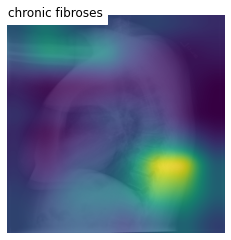

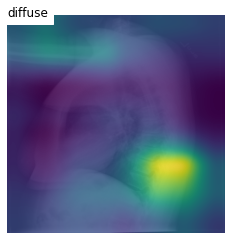

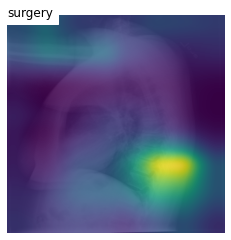

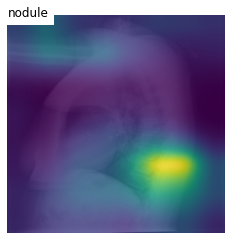

torch.Size([256, 14, 14])


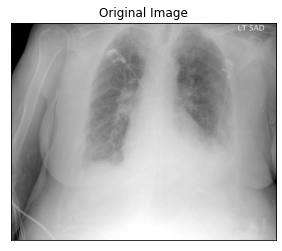

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


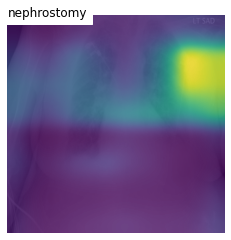

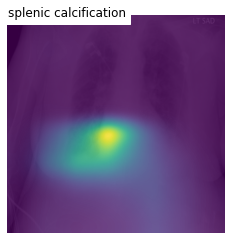

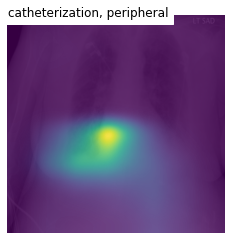

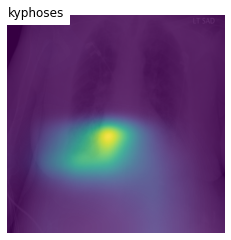

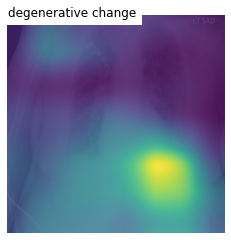

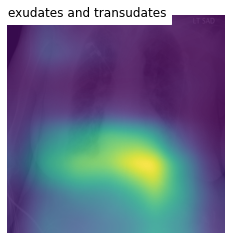

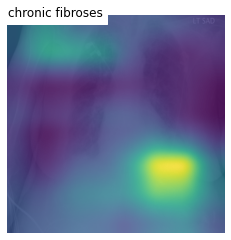

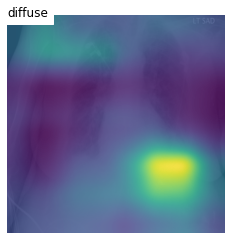

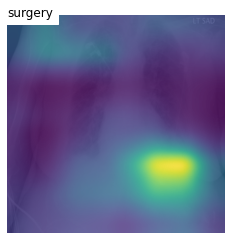

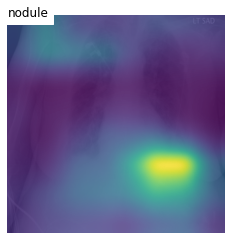

torch.Size([272, 14, 14])


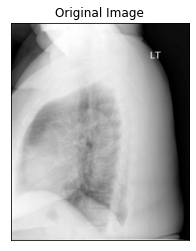

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


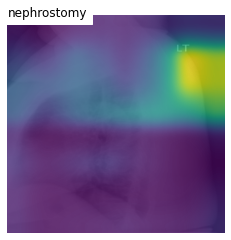

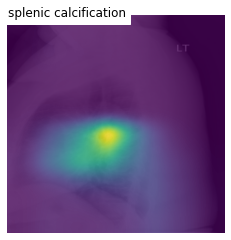

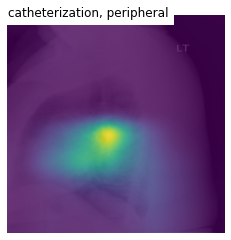

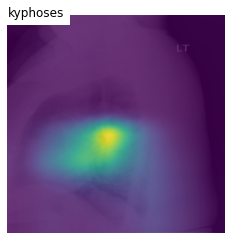

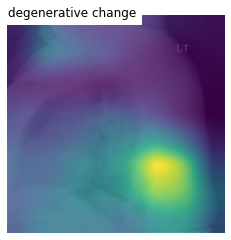

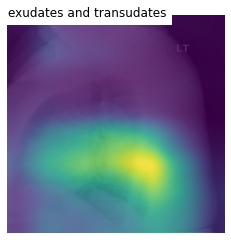

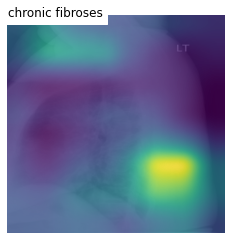

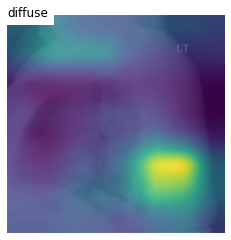

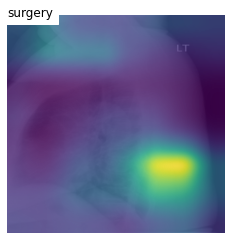

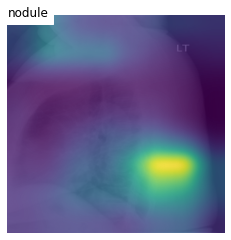

torch.Size([288, 14, 14])


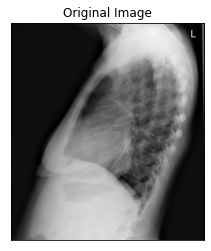

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


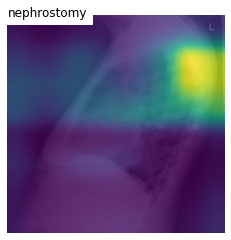

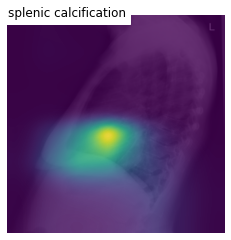

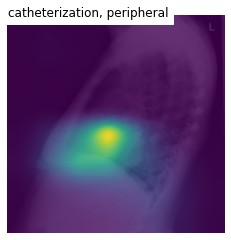

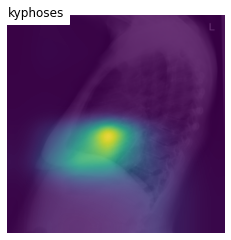

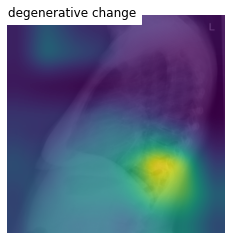

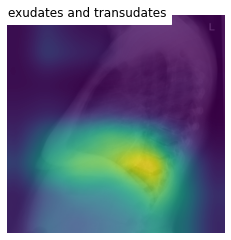

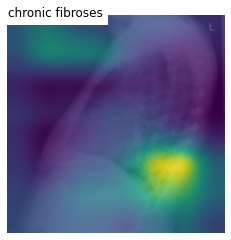

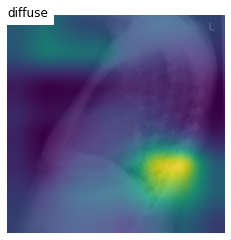

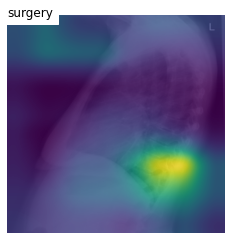

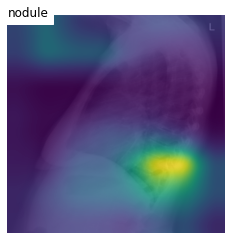

torch.Size([304, 14, 14])


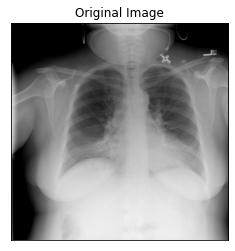

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


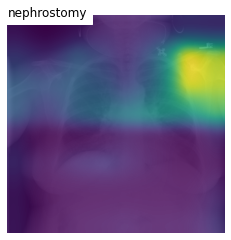

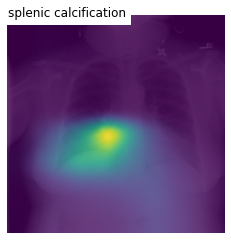

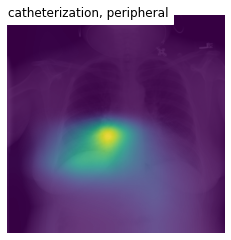

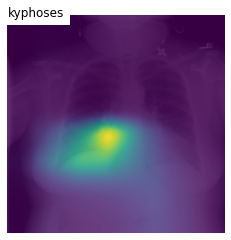

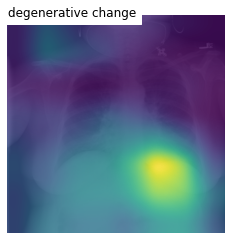

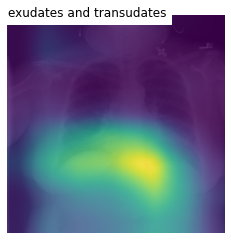

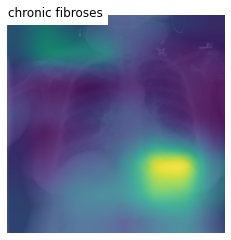

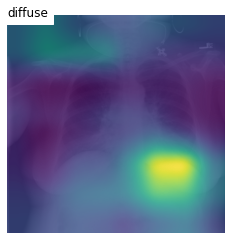

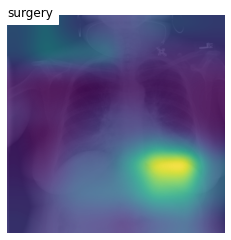

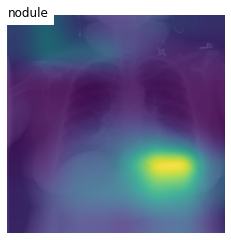

torch.Size([320, 14, 14])


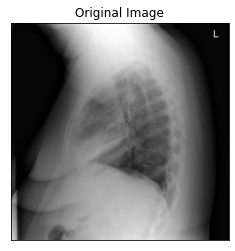

True ['nephrostomy', 'splenic calcification', 'arthroplasty, replacement', 'contusion', 'degenerative arthritis', 'retraction', 'enlarged ', 'catheterization, central venous', 'lipoma', 'ectasia', 'nodule', 'interstitial', 'obesity, morbid']
Predictions ['nephrostomy', 'splenic calcification', 'catheterization, peripheral', 'kyphoses', 'degenerative change', 'exudates and transudates', 'chronic fibroses', 'diffuse', 'surgery', 'nodule']


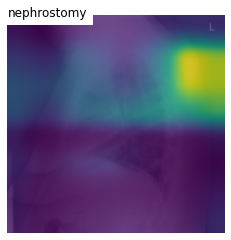

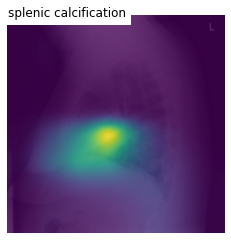

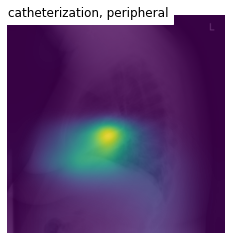

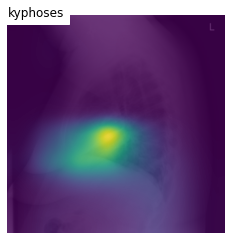

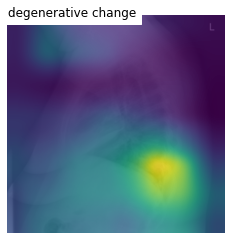

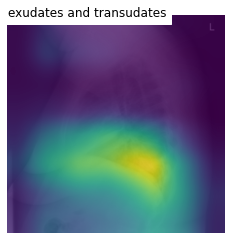

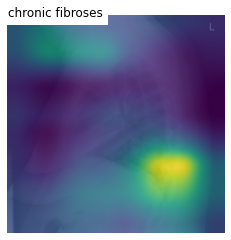

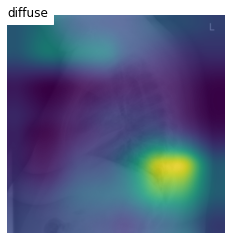

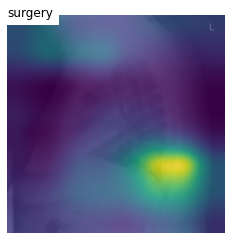

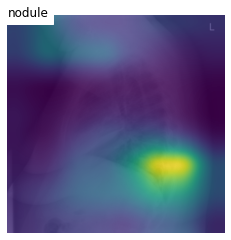

torch.Size([399, 14, 14])


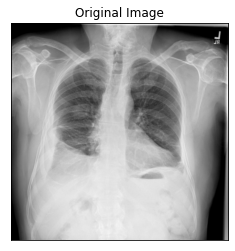

True ['nephrostomy', 'splenic calcification', 'implanted medical device', 'arthroplasty, replacement', 'chest tubes', 'bone', 'kyphoses', 'neoplasm', 'right', 'intervertebral disc displacement', 'lymph', 'chronic fibroses', 'surgery', 'nodule', 'osteophytes', 'thoracolumbar scolioses', 'interstitial']
Predictions ['nephrostomy', 'arthroplasty, replacement', 'enchondroma', 'granulomatous infection', 'chest tubes', 'kyphoses', 'degenerative change', 'postoperative period', 'chronic fibroses', 'surgery', 'nodule', 'osteophytes', 'interstitial']


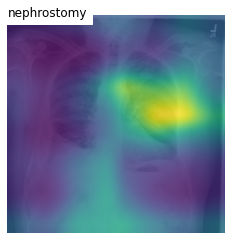

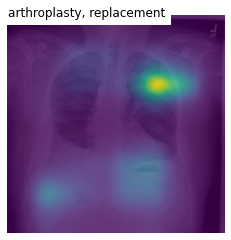

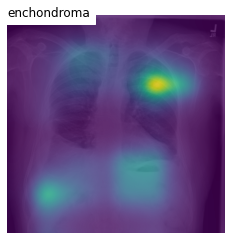

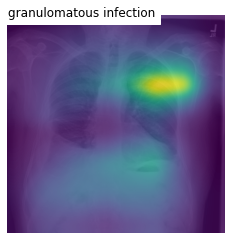

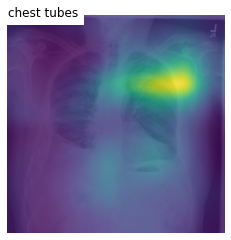

...

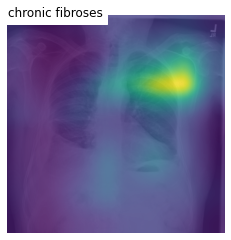

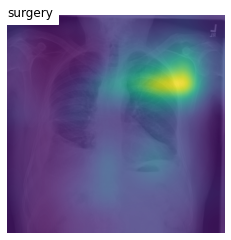

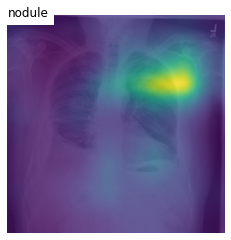

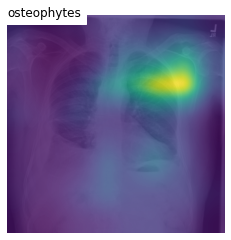

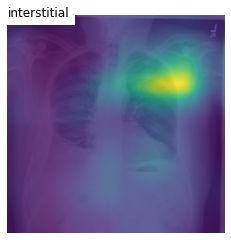

torch.Size([418, 14, 14])


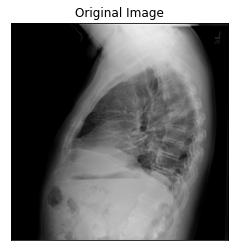

True ['nephrostomy', 'splenic calcification', 'implanted medical device', 'arthroplasty, replacement', 'chest tubes', 'bone', 'kyphoses', 'neoplasm', 'right', 'intervertebral disc displacement', 'lymph', 'chronic fibroses', 'surgery', 'nodule', 'osteophytes', 'thoracolumbar scolioses', 'interstitial']
Predictions ['nephrostomy', 'catheterization, peripheral', 'chest tubes', 'kyphoses', 'degenerative change', 'granulomas', 'chronic fibroses', 'surgery', 'nodule', 'interstitial']


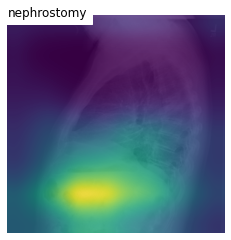

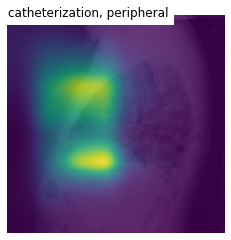

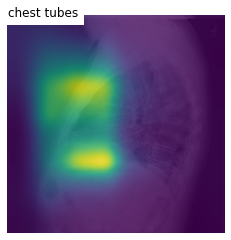

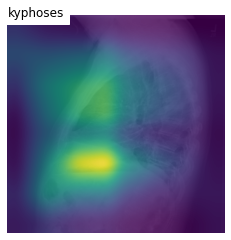

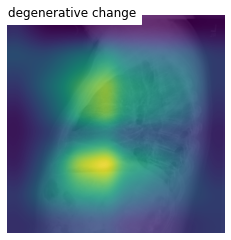

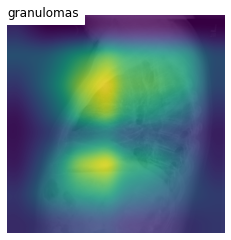

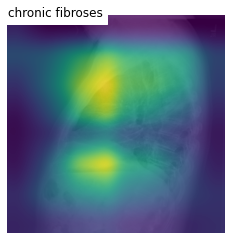

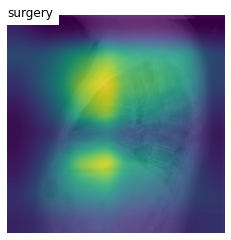

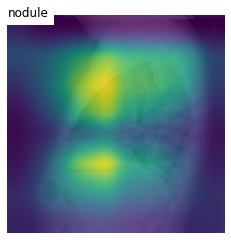

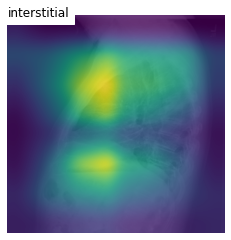

torch.Size([437, 14, 14])


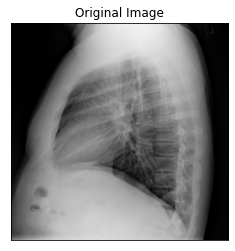

True ['nephrostomy', 'splenic calcification', 'implanted medical device', 'arthroplasty, replacement', 'chest tubes', 'bone', 'kyphoses', 'neoplasm', 'right', 'intervertebral disc displacement', 'lymph', 'chronic fibroses', 'surgery', 'nodule', 'osteophytes', 'thoracolumbar scolioses', 'interstitial']
Predictions ['nephrostomy', 'catheterization, peripheral', 'chest tubes', 'kyphoses', 'degenerative change', 'granulomas', 'chronic fibroses', 'surgery', 'nodule', 'interstitial']


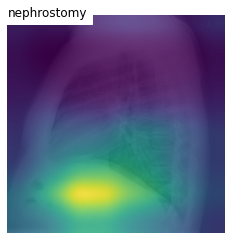

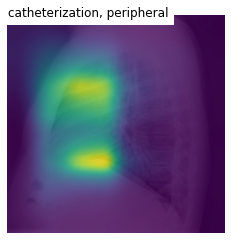

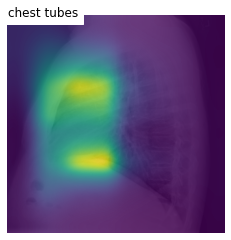

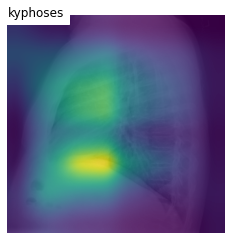

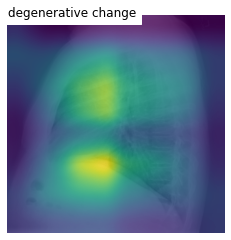

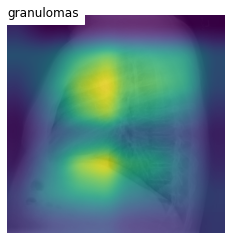

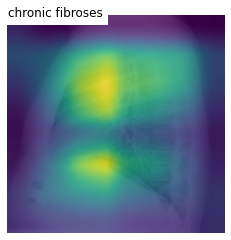

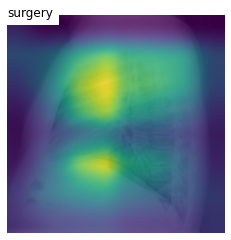

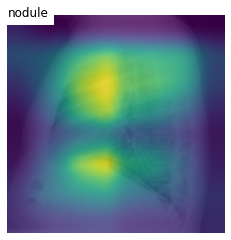

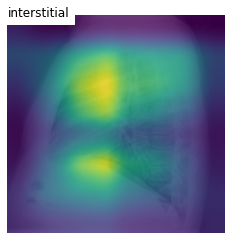

torch.Size([456, 14, 14])


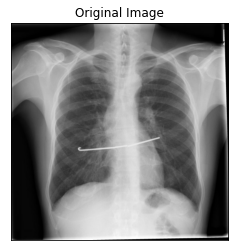

True ['nephrostomy', 'splenic calcification', 'implanted medical device', 'arthroplasty, replacement', 'chest tubes', 'bone', 'kyphoses', 'neoplasm', 'right', 'intervertebral disc displacement', 'lymph', 'chronic fibroses', 'surgery', 'nodule', 'osteophytes', 'thoracolumbar scolioses', 'interstitial']
Predictions ['nephrostomy', 'catheterization, peripheral', 'chest tubes', 'kyphoses', 'degenerative change', 'granulomas', 'chronic fibroses', 'surgery', 'nodule', 'interstitial']


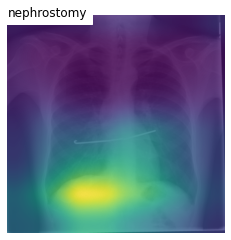

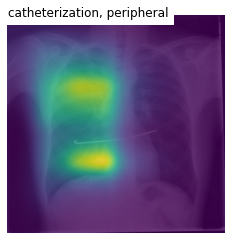

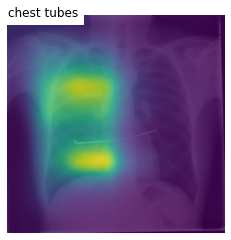

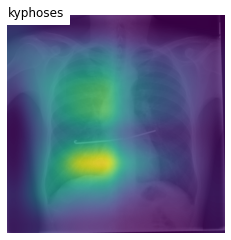

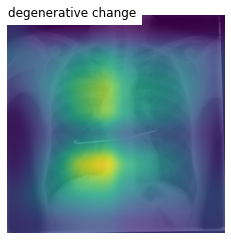

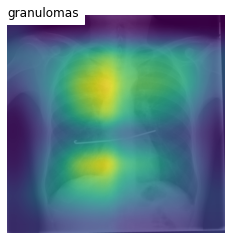

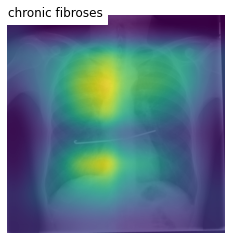

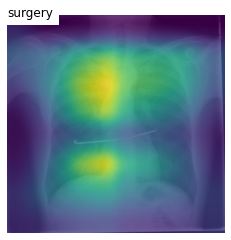

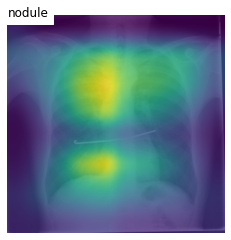

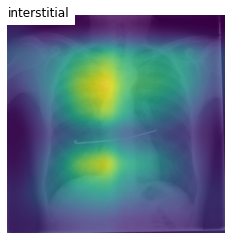

torch.Size([475, 14, 14])


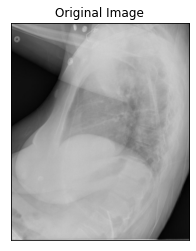

True ['nephrostomy', 'splenic calcification', 'implanted medical device', 'arthroplasty, replacement', 'chest tubes', 'bone', 'kyphoses', 'neoplasm', 'right', 'intervertebral disc displacement', 'lymph', 'chronic fibroses', 'surgery', 'nodule', 'osteophytes', 'thoracolumbar scolioses', 'interstitial']
Predictions ['nephrostomy', 'catheterization, peripheral', 'chest tubes', 'kyphoses', 'degenerative change', 'granulomas', 'chronic fibroses', 'surgery', 'nodule', 'interstitial']


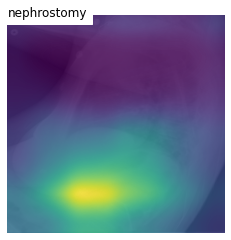

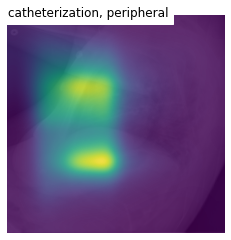

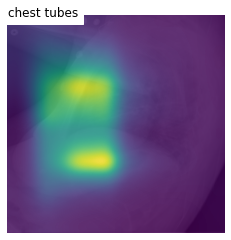

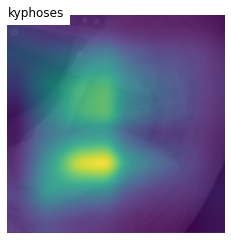

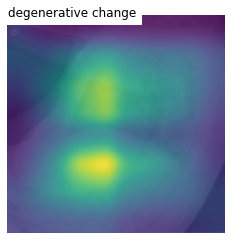

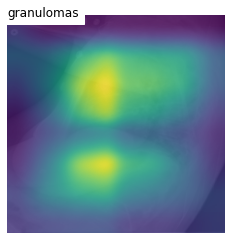

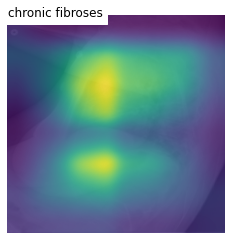

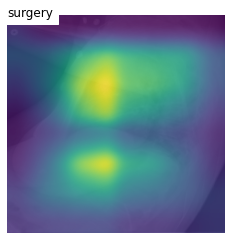

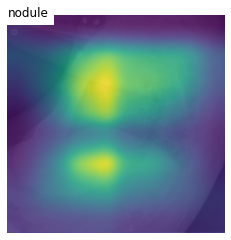

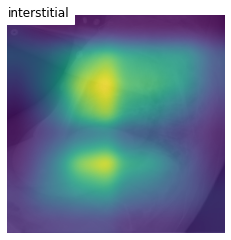

torch.Size([494, 14, 14])


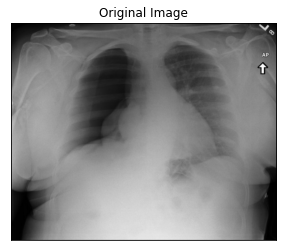

True ['nephrostomy', 'splenic calcification', 'implanted medical device', 'arthroplasty, replacement', 'chest tubes', 'bone', 'kyphoses', 'neoplasm', 'right', 'intervertebral disc displacement', 'lymph', 'chronic fibroses', 'surgery', 'nodule', 'osteophytes', 'thoracolumbar scolioses', 'interstitial']
Predictions ['nephrostomy', 'catheterization, peripheral', 'chest tubes', 'kyphoses', 'degenerative change', 'granulomas', 'chronic fibroses', 'surgery', 'nodule', 'interstitial']


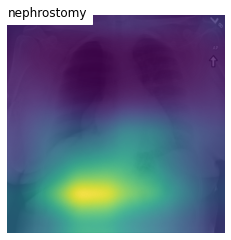

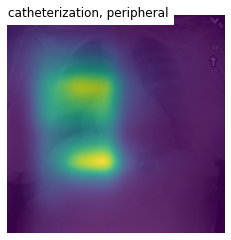

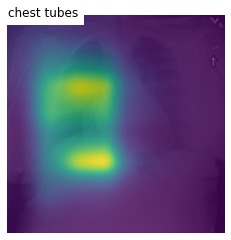

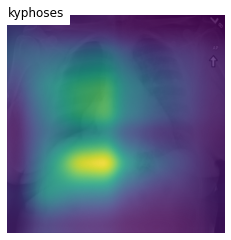

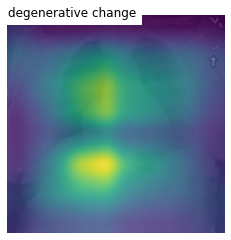

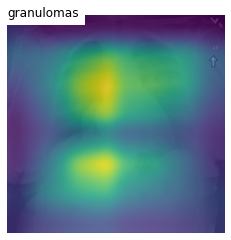

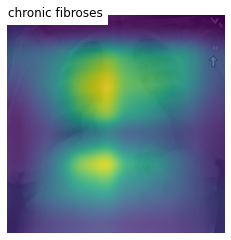

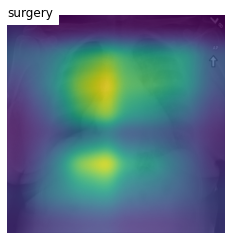

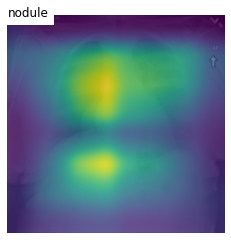

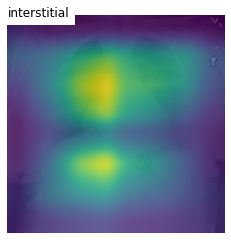

torch.Size([513, 14, 14])


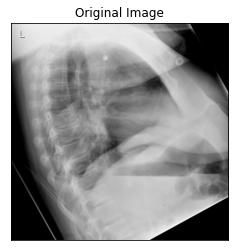

True ['nephrostomy', 'splenic calcification', 'implanted medical device', 'arthroplasty, replacement', 'chest tubes', 'bone', 'kyphoses', 'neoplasm', 'right', 'intervertebral disc displacement', 'lymph', 'chronic fibroses', 'surgery', 'nodule', 'osteophytes', 'thoracolumbar scolioses', 'interstitial']
Predictions ['nephrostomy', 'catheterization, peripheral', 'chest tubes', 'kyphoses', 'degenerative change', 'granulomas', 'chronic fibroses', 'surgery', 'nodule', 'interstitial']


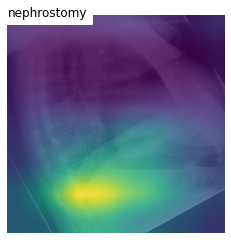

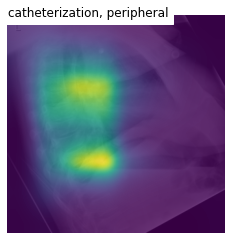

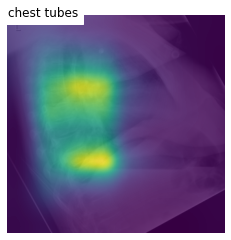

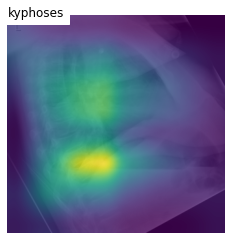

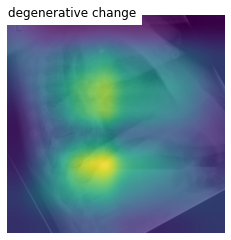

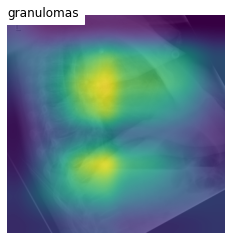

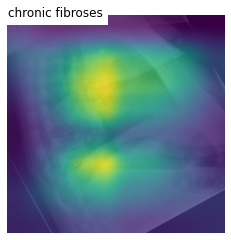

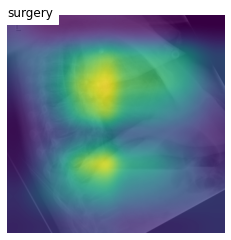

KeyboardInterrupt: ignored

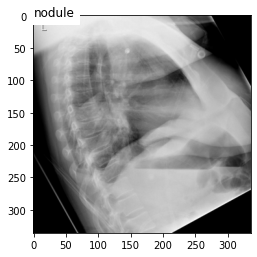

In [0]:
import torch
from torch import nn
from matplotlib import pyplot as plt
import time

from utils.constants import epochs, encoder_lr, decoder_lr, alpha_c, emb_dim, attention_dim, decoder_dim, dropout
from models.mlc.attention_LSTM import Encoder, DecoderWithAttention, Attention
from utils.utils import f1_score, eval, process_predictions, analyze_mistakes, save_models, save_metrics
from models.mlc.attention_LSTM import train_step, train_epoch, train, prediction, visualize_attention

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 

for ENCODER_NAME in ['densenet']:
    for USE_NEGATIVES in [True, False]: 
      decoder=encoder=encoder_optimizer=decoder_optimizer=None
      # define models
      decoder = DecoderWithAttention(attention_dim=attention_dim,
                                      embed_dim=emb_dim,
                                      decoder_dim=decoder_dim,
                                      vocab_size=UNIQUE_TAGS,
                                      encoder_dim = encoder_encoderdim_mapping[ENCODER_NAME],
                                      dropout=dropout)
      decoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, decoder.parameters()), lr=decoder_lr)
      encoder = Encoder(encoder_name=ENCODER_NAME)
      encoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, encoder.parameters()), lr=encoder_lr)

      decoder = decoder.to(device)
      encoder = encoder.to(device)
      criterion = nn.CrossEntropyLoss().to(device)

      # train 
      start = time.time()
      train_metrics,valid_metrics, test_metrics, encoder, decoder = train(0, epochs, train_set, valid_set, test_set, tag_to_index, UNIQUE_TAGS, 
                      encoder, decoder, decoder_optimizer, encoder_optimizer, criterion, device, include_negatives=USE_NEGATIVES, verbose=False)
      end = time.time()
      negative_samples_label = 'negative sampling'
      if not USE_NEGATIVES:
        negative_samples_label = 'no negative sampling'

      # print test set results
      print('=====================================================================================================')
      print(f'Model name: Attention LSTM with {ENCODER_NAME} and {negative_samples_label}')
      pre, rec, ovpre, ovrec, macroF1, microF1, instanceF1, ham_loss, auc = test_metrics
      print('Test set performance')
      print(f'Precision {pre} Recall {rec} Overall Precision {ovpre} Overall Recall {ovrec} Macro F1 {macroF1}')
      print(f'Micro F1 {microF1} Instance F1 {instanceF1} Hamming loss {ham_loss} AUC {auc}')
      print(f'Training time {end-start}')

      # plot train results
      plt.plot(valid_metrics[:,0], label = 'val')
      plt.plot(train_metrics[:,0], label = 'tra')
      plt.title(f'Loss with {ENCODER_NAME} and {negative_samples_label}')
      plt.legend()
      plt.show()

      # save to disk 
      save_models(ENCODER_NAME, USE_NEGATIVES, encoder, decoder)
      save_metrics(ENCODER_NAME, USE_NEGATIVES, train_metrics, valid_metrics, test_metrics)  

      # mistakes analysis
      true, predicted, pred_scores = prediction(encoder, decoder, device, test_set, tag_to_index, UNIQUE_TAGS)
      _ = analyze_mistakes(true, predicted, pred_scores, train_set, tag_to_index, make_plots=True)

      # visualizations
      visualize_attention(tag_to_index, test_set, UNIQUE_TAGS, encoder, decoder, device)

# Experiments Section on LSTM without Attention (with densenet only as its results are the best and using negative samples)

Downloading: "https://github.com/pytorch/vision/archive/v0.5.0.zip" to /root/.cache/torch/hub/v0.5.0.zip
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/checkpoints/densenet121-a639ec97.pth


Downloading: "https://github.com/pytorch/vision/archive/v0.5.0.zip" to /root/.cache/torch/hub/v0.5.0.zip
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/checkpoints/densenet121-a639ec97.pth




DECAYING learning rate.
The new learning rate is 0.000320


DECAYING learning rate.
The new learning rate is 0.000160


DECAYING learning rate.
The new learning rate is 0.000320


DECAYING learning rate.
The new learning rate is 0.000160


DECAYING learning rate.
The new learning rate is 0.000256


DECAYING learning rate.
The new learning rate is 0.000128


DECAYING learning rate.
The new learning rate is 0.000256


DECAYING learning rate.
The new learning rate is 0.000128


DECAYING learning rate.
The new learning rate is 0.000205


DECAYING learning rate.
The new learning rate is 0.000102


DECAYING learning rate.
The new learning rate is 0.000205


DECAYING learning rate.
The new learning rate is 0.000102


DECAYING learning rate.
The new learning rate is 0.000164


DECAYING learning rate.
The new learning rate is 0.000082


DECAYING learning rate.
The new learning rate is 0.000164


DECAYING learning rate.
The new learning rate is 0.000082

Model name: Attention LSTM with densene

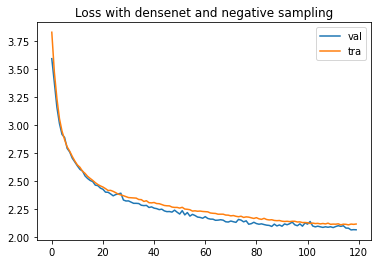

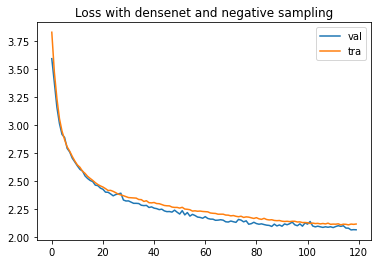

10 best predictions of the model
10 best predictions of the model


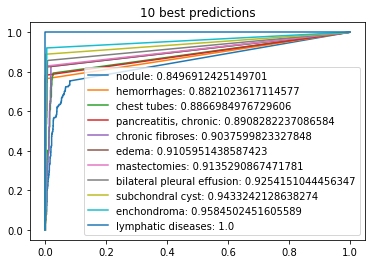

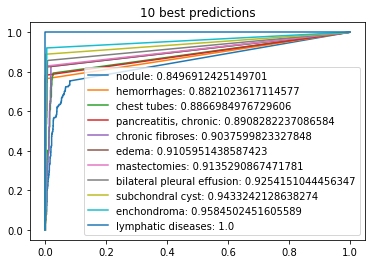

10 worst predictions of the model10 worst predictions of the model



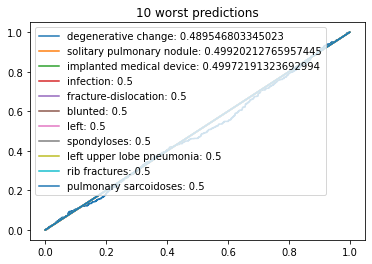

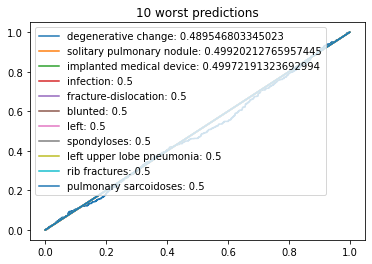

Score vs Number of samplesScore vs Number of samples



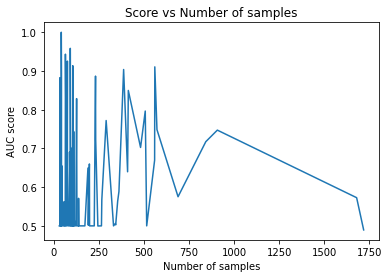

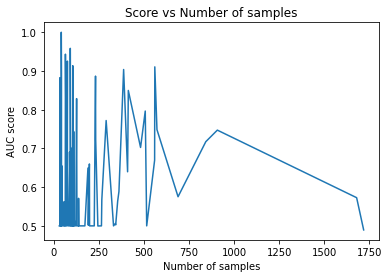

In [0]:
import torch
from torch import nn
from matplotlib import pyplot as plt
import time

from utils.constants import epochs, encoder_lr, decoder_lr, emb_dim, decoder_dim, dropout
from models.mlc.LSTM_no_attention import Decoder
from models.mlc.attention_LSTM import Encoder
from utils.utils import f1_score, eval, process_predictions, analyze_mistakes, save_models, save_metrics
from models.mlc.attention_LSTM import train_step, train_epoch, train, prediction, visualize_attention

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 
ENCODER_NAME = 'densenet' # we experimet with no attention only for one model
USE_NEGATIVES = True

decoder=encoder=encoder_optimizer=decoder_optimizer=None
# define models
decoder = Decoder(embed_dim=emb_dim,
                                decoder_dim=decoder_dim,
                                vocab_size=UNIQUE_TAGS,
                                encoder_dim=encoder_encoderdim_mapping[ENCODER_NAME],
                                dropout=dropout)
decoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, decoder.parameters()), lr=decoder_lr)
encoder = Encoder()
encoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, encoder.parameters()), lr=encoder_lr)

decoder = decoder.to(device)
encoder = encoder.to(device)
criterion = nn.CrossEntropyLoss().to(device)

# train 
start = time.time()
train_metrics,valid_metrics, test_metrics, encoder, decoder = train(0, epochs, train_set, valid_set, test_set, tag_to_index, UNIQUE_TAGS, 
                  encoder, decoder, decoder_optimizer, encoder_optimizer, criterion, device, include_negatives=True, verbose=False, attention=False)
end = time.time()
negative_samples_label = 'negative sampling'
if not USE_NEGATIVES:
  negative_samples_label = 'no negative sampling'

# print test set results
print(f'Model name: Attention LSTM with {ENCODER_NAME} and {negative_samples_label}')
pre, rec, ovpre, ovrec, macroF1, microF1, instanceF1, ham_loss, auc = test_metrics
print('Test set performance')
print(f'Precision {pre} Recall {rec} Overall Precision {ovpre} Overall Recall {ovrec} Macro F1 {macroF1}\
      Micro F1 {microF1} Instance F1 {instanceF1} Hamming loss {ham_loss} AUC {auc}')
print(f'Training time {end-start}')

# plot train results
plt.plot(valid_metrics[:,0], label = 'val')
plt.plot(train_metrics[:,0], label = 'tra')
plt.title(f'Loss with {ENCODER_NAME} and {negative_samples_label}')
plt.legend()
plt.show()

# save to disk 
save_models(ENCODER_NAME, True, encoder, decoder)
save_metrics(ENCODER_NAME, True, train_metrics, valid_metrics, test_metrics)

# mistakes analysis
true, predicted, pred_scores = prediction(encoder, decoder, device, test_set, tag_to_index, UNIQUE_TAGS)
_ = analyze_mistakes(true, predicted, pred_scores, train_set, tag_to_index, make_plots=True)

# Experiment with only 30 most frequent labels to be classified (model with attention and densenet visual features encoder)

Downloading: "https://github.com/pytorch/vision/archive/v0.5.0.zip" to /root/.cache/torch/hub/v0.5.0.zip
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/checkpoints/densenet121-a639ec97.pth




DECAYING learning rate.
The new learning rate is 0.000320


DECAYING learning rate.
The new learning rate is 0.000160


DECAYING learning rate.
The new learning rate is 0.000256


DECAYING learning rate.
The new learning rate is 0.000128


DECAYING learning rate.
The new learning rate is 0.000205


DECAYING learning rate.
The new learning rate is 0.000102


DECAYING learning rate.
The new learning rate is 0.000164


DECAYING learning rate.
The new learning rate is 0.000082


DECAYING learning rate.
The new learning rate is 0.000131


DECAYING learning rate.
The new learning rate is 0.000066


DECAYING learning rate.
The new learning rate is 0.000105


DECAYING learning rate.
The new learning rate is 0.000052

Model name: Attention LSTM with densenet and negative sampling
Test set performance
Precision 0.4814507772020725 Recall 0.4814507772020725 Overall Precision 0.3629802715283453 Overall Recall 0.3629802715283453 Macro F1 0.004785000247176131
Micro F1 0.43772376107028454 Instance F

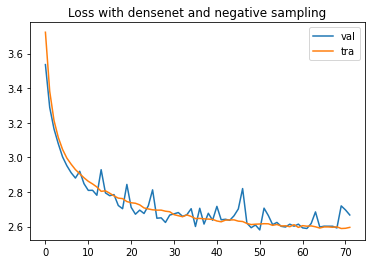

10 best predictions of the model


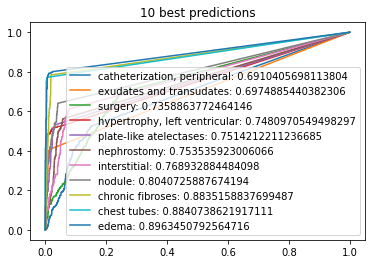

10 worst predictions of the model


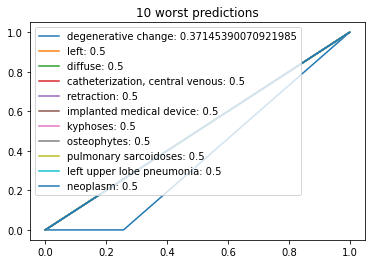

Score vs Number of samples


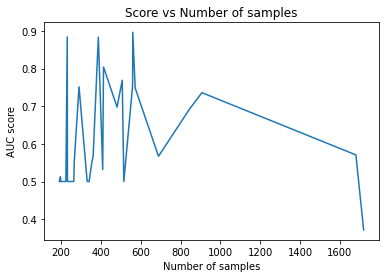

torch.Size([2, 14, 14])


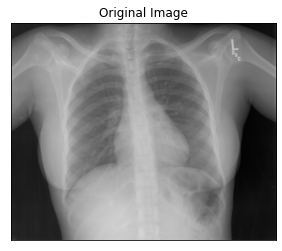

True ['degenerative change']
Predictions ['degenerative change']


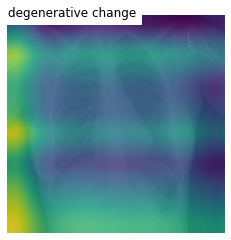

torch.Size([10, 14, 14])


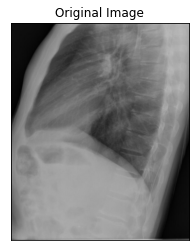

True ['splenic calcification', 'surgery', 'catheterization, central venous', 'pulmonary sarcoidoses']
Predictions ['degenerative change', 'splenic calcification', 'surgery']


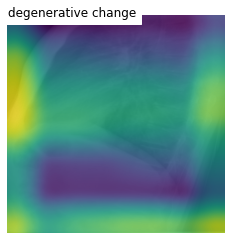

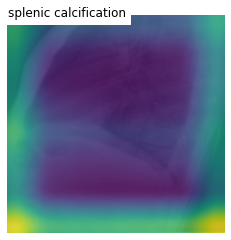

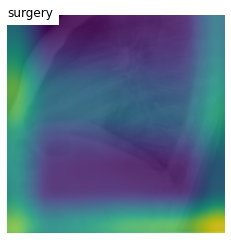

torch.Size([15, 14, 14])


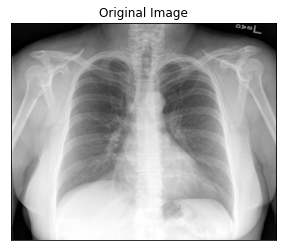

True ['splenic calcification', 'surgery', 'catheterization, central venous', 'pulmonary sarcoidoses']
Predictions ['degenerative change', 'splenic calcification', 'surgery']


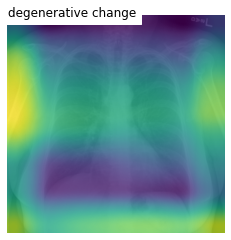

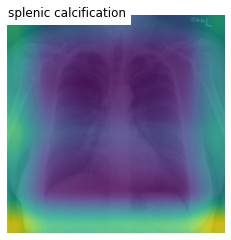

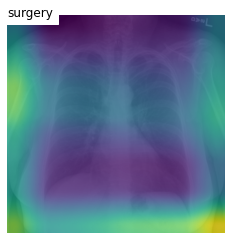

torch.Size([28, 14, 14])


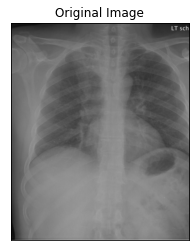

True ['splenic calcification', 'surgery', 'nephrostomy', 'nodule', 'chronic fibroses', 'pulmonary sarcoidoses']
Predictions ['degenerative change', 'surgery', 'arthroplasty, replacement', 'chronic fibroses']


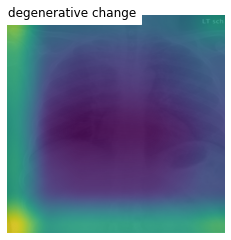

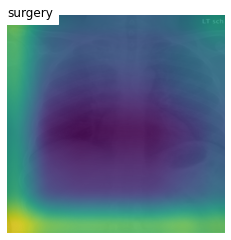

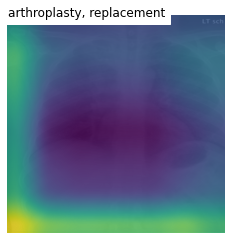

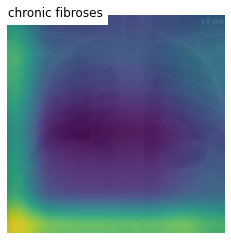

torch.Size([35, 14, 14])


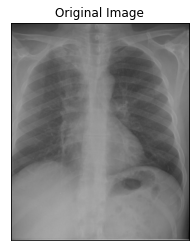

True ['splenic calcification', 'surgery', 'nephrostomy', 'nodule', 'chronic fibroses', 'pulmonary sarcoidoses']
Predictions ['degenerative change', 'surgery', 'arthroplasty, replacement', 'chronic fibroses']


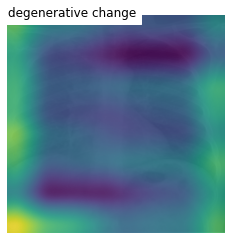

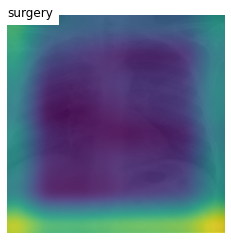

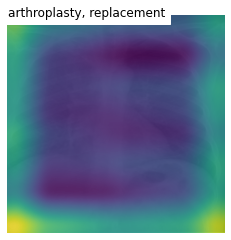

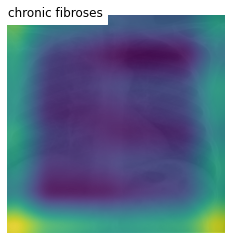

torch.Size([42, 14, 14])


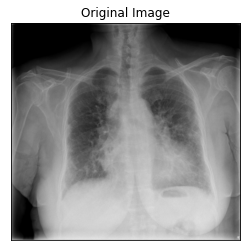

True ['splenic calcification', 'surgery', 'nephrostomy', 'nodule', 'chronic fibroses', 'pulmonary sarcoidoses']
Predictions ['degenerative change', 'surgery', 'arthroplasty, replacement', 'chronic fibroses']


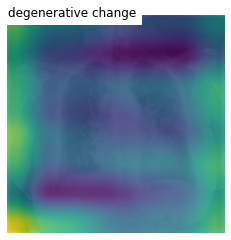

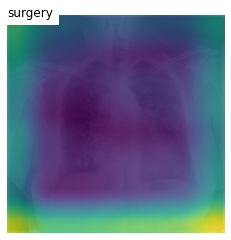

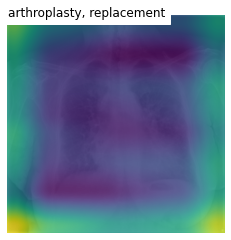

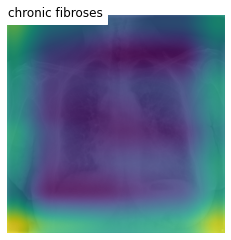

torch.Size([63, 14, 14])


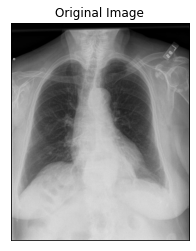

True ['splenic calcification', 'arthroplasty, replacement', 'nephrostomy', 'interstitial', 'nodule', 'degenerative arthritis', 'catheterization, central venous', 'retraction']
Predictions ['degenerative change', 'splenic calcification', 'surgery', 'interstitial', 'exudates and transudates', 'nodule', 'pneumonia right lower lobe', 'chronic fibroses']


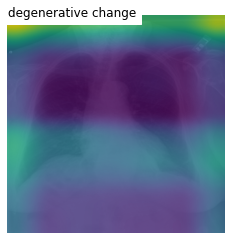

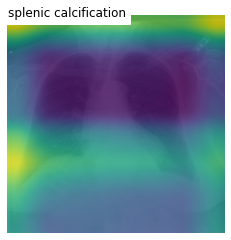

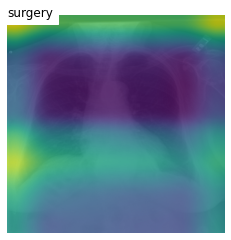

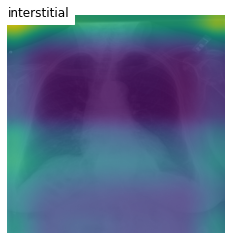

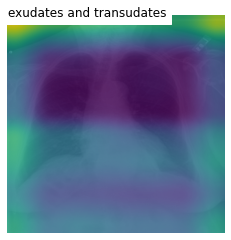

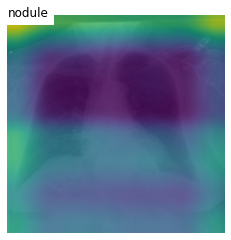

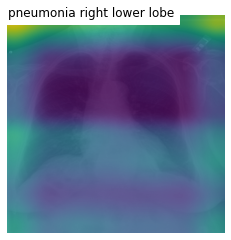

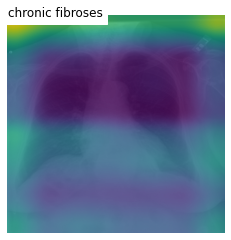

torch.Size([72, 14, 14])


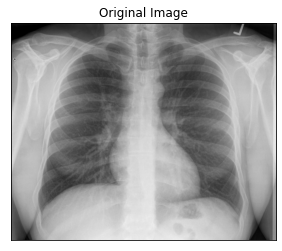

True ['splenic calcification', 'arthroplasty, replacement', 'nephrostomy', 'interstitial', 'nodule', 'degenerative arthritis', 'catheterization, central venous', 'retraction']
Predictions ['degenerative change', 'splenic calcification', 'surgery', 'interstitial', 'exudates and transudates', 'nodule', 'pneumonia right lower lobe', 'chronic fibroses']


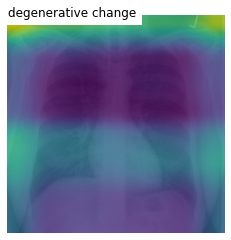

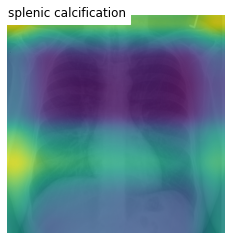

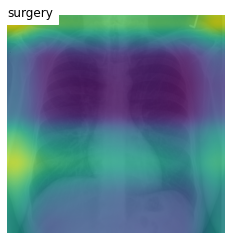

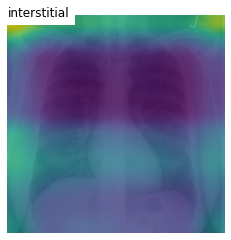

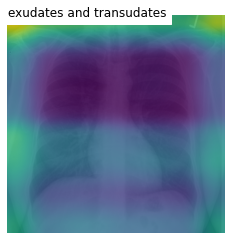

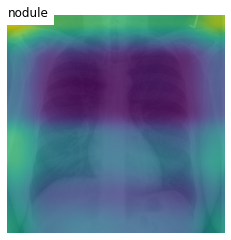

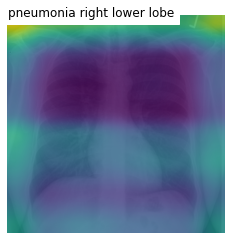

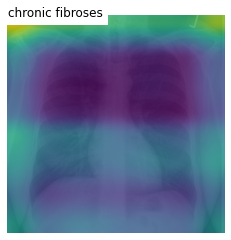

torch.Size([81, 14, 14])


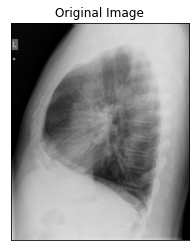

True ['splenic calcification', 'arthroplasty, replacement', 'nephrostomy', 'interstitial', 'nodule', 'degenerative arthritis', 'catheterization, central venous', 'retraction']
Predictions ['degenerative change', 'splenic calcification', 'surgery', 'interstitial', 'exudates and transudates', 'nodule', 'pneumonia right lower lobe', 'chronic fibroses']


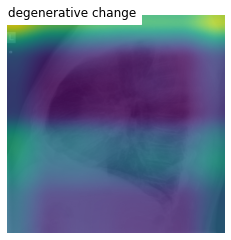

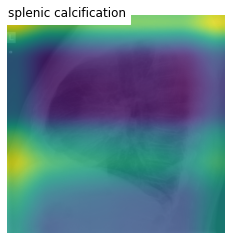

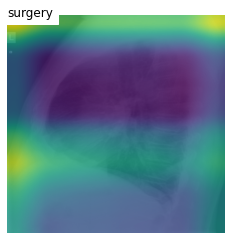

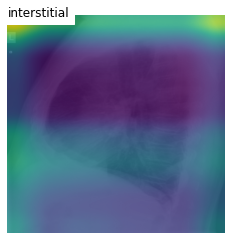

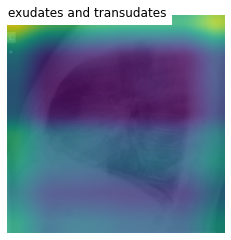

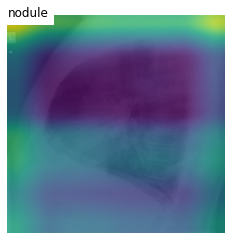

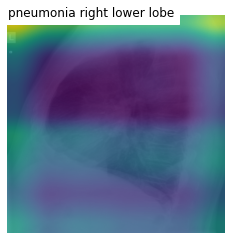

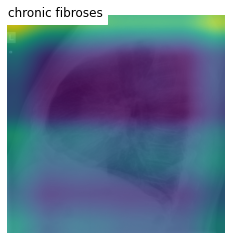

torch.Size([90, 14, 14])


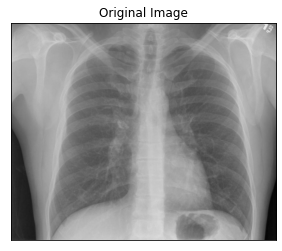

True ['splenic calcification', 'arthroplasty, replacement', 'nephrostomy', 'interstitial', 'nodule', 'degenerative arthritis', 'catheterization, central venous', 'retraction']
Predictions ['degenerative change', 'splenic calcification', 'surgery', 'interstitial', 'exudates and transudates', 'nodule', 'pneumonia right lower lobe', 'chronic fibroses']


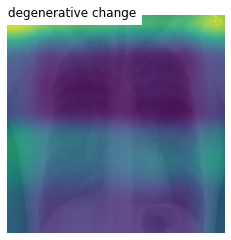

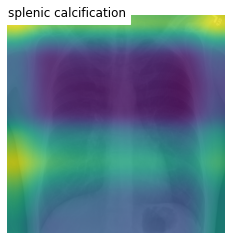

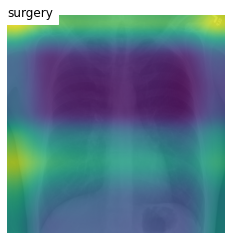

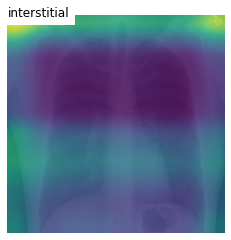

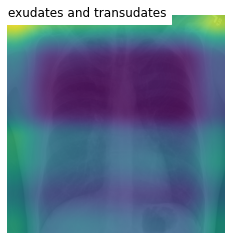

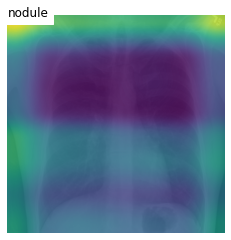

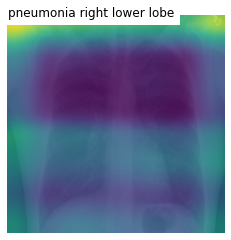

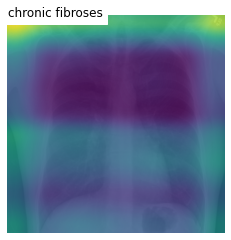

torch.Size([99, 14, 14])


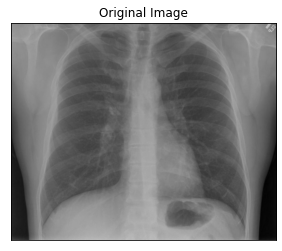

True ['splenic calcification', 'arthroplasty, replacement', 'nephrostomy', 'interstitial', 'nodule', 'degenerative arthritis', 'catheterization, central venous', 'retraction']
Predictions ['degenerative change', 'splenic calcification', 'surgery', 'interstitial', 'exudates and transudates', 'nodule', 'pneumonia right lower lobe', 'chronic fibroses']


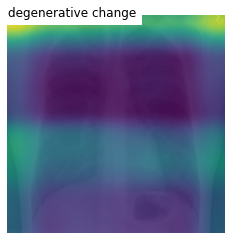

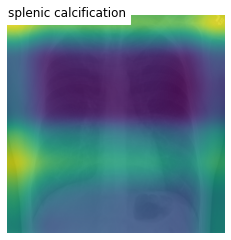

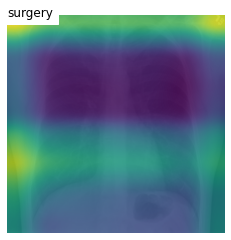

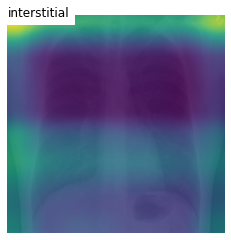

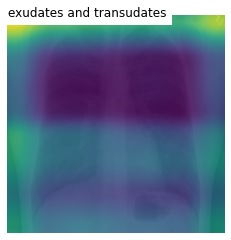

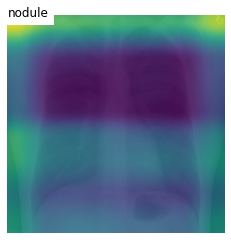

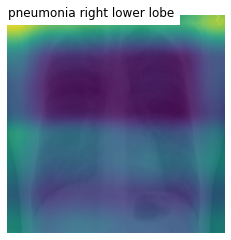

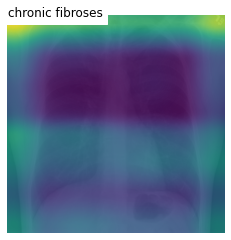

torch.Size([108, 14, 14])


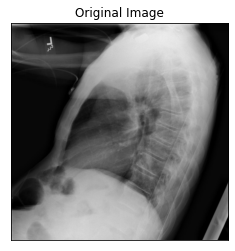

True ['splenic calcification', 'arthroplasty, replacement', 'nephrostomy', 'interstitial', 'nodule', 'degenerative arthritis', 'catheterization, central venous', 'retraction']
Predictions ['degenerative change', 'splenic calcification', 'surgery', 'interstitial', 'exudates and transudates', 'nodule', 'pneumonia right lower lobe', 'chronic fibroses']


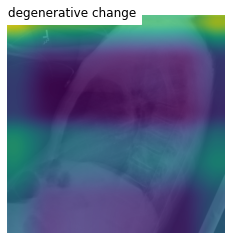

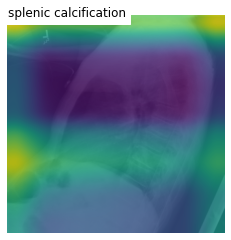

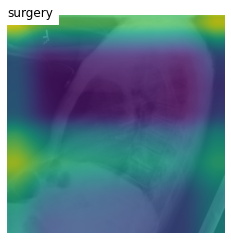

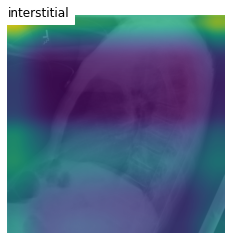

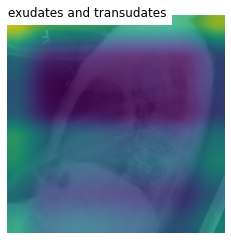

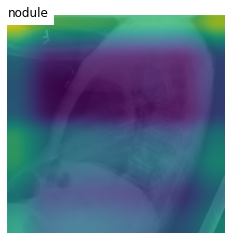

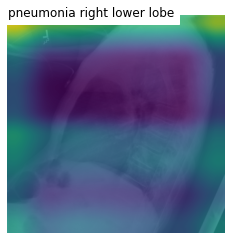

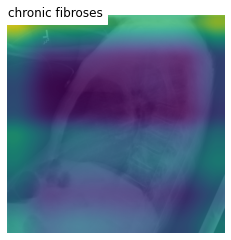

torch.Size([117, 14, 14])


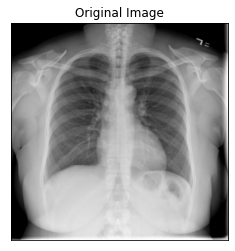

True ['splenic calcification', 'arthroplasty, replacement', 'nephrostomy', 'interstitial', 'nodule', 'degenerative arthritis', 'catheterization, central venous', 'retraction']
Predictions ['degenerative change', 'splenic calcification', 'surgery', 'interstitial', 'exudates and transudates', 'nodule', 'pneumonia right lower lobe', 'chronic fibroses']


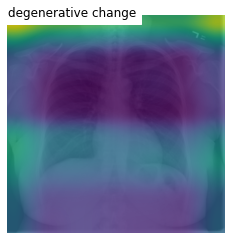

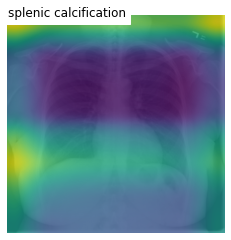

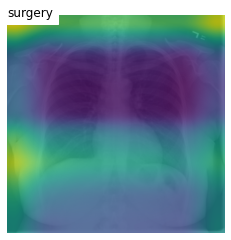

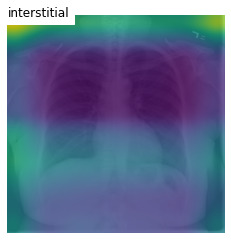

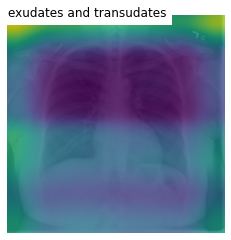

In [0]:
from collections import Counter
import torch
from torch import nn
from matplotlib import pyplot as plt
import time

from utils.constants import epochs, encoder_lr, decoder_lr, alpha_c, emb_dim, attention_dim, decoder_dim, dropout
from models.mlc.attention_LSTM import Encoder, DecoderWithAttention, Attention
from utils.utils import f1_score, eval, process_predictions, analyze_mistakes, save_models, save_metrics
from models.mlc.attention_LSTM import train_step, train_epoch, train, prediction, visualize_attention

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 
# refactor data, leave only 30 most common labels, keep others as negative samples
number_of_tags = Counter()
for img in train_set:
  for tag in train_set[img]:
    number_of_tags[tag] += 1
number_of_tags = number_of_tags.most_common(30)
tag_to_index = {x[0]:i for i, x in enumerate(number_of_tags)}
tag_to_index['start'] = len(tag_to_index)
tag_to_index['end'] = len(tag_to_index)
tag_to_index['pad'] = len(tag_to_index)
UNIQUE_TAGS = len(tag_to_index)

# now delete labels that occure less than 30 times
def leave_30(data_set, tag_to_index, train=True):
  data_set_new = {}
  for img in data_set:
    new_tags = []
    for tag in data_set[img]:
      if tag in tag_to_index:
        new_tags.append(tag)
    if train or len(new_tags):
      data_set_new[img] = new_tags
  return data_set_new

train_set, valid_set, test_set = leave_30(train_set, tag_to_index), leave_30(valid_set, tag_to_index, train=False), leave_30(test_set, tag_to_index, train=False)
train_set, valid_set, test_set = apply_hierarchy(train_set, valid_set, test_set)


# start experiments
ENCODER_NAME = 'densenet'

for USE_NEGATIVES in [True, False]:
  decoder = DecoderWithAttention(attention_dim=attention_dim,
                                  embed_dim=emb_dim,
                                  decoder_dim=decoder_dim,
                                  vocab_size=UNIQUE_TAGS,
                                  encoder_dim = encoder_encoderdim_mapping[ENCODER_NAME],
                                  dropout=dropout)
  decoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, decoder.parameters()), lr=decoder_lr)
  encoder = Encoder(encoder_name=ENCODER_NAME)
  encoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, encoder.parameters()), lr=encoder_lr)

  decoder = decoder.to(device)
  encoder = encoder.to(device)
  criterion = nn.CrossEntropyLoss().to(device)

  # train 
  start = time.time()
  train_metrics,valid_metrics, test_metrics, encoder, decoder = train(0, epochs, train_set, valid_set, test_set, tag_to_index, UNIQUE_TAGS, 
                  encoder, decoder, decoder_optimizer, encoder_optimizer, criterion, device, include_negatives=USE_NEGATIVES, verbose=False)
  end = time.time()
  negative_samples_label = 'negative sampling'
  if not USE_NEGATIVES:
    negative_samples_label = 'no negative sampling'

  # print test set results
  print('=====================================================================================================')
  print(f'Model name: Attention LSTM with {ENCODER_NAME} and {negative_samples_label}')
  pre, rec, ovpre, ovrec, macroF1, microF1, instanceF1, ham_loss, auc = test_metrics
  print('Test set performance')
  print(f'Precision {pre} Recall {rec} Overall Precision {ovpre} Overall Recall {ovrec} Macro F1 {macroF1}')
  print(f'Micro F1 {microF1} Instance F1 {instanceF1} Hamming loss {ham_loss} AUC {auc}')
  print(f'Training time {end-start}')

  # plot train results
  plt.plot(valid_metrics[:,0], label = 'val')
  plt.plot(train_metrics[:,0], label = 'tra')
  plt.title(f'Loss with {ENCODER_NAME} and {negative_samples_label}')
  plt.legend()
  plt.show()

  # save to disk 
  save_models(ENCODER_NAME, USE_NEGATIVES, encoder, decoder)
  save_metrics(ENCODER_NAME, USE_NEGATIVES, train_metrics, valid_metrics, test_metrics)

  # mistakes analysis
  true, predicted, pred_scores = prediction(encoder, decoder, device, test_set, tag_to_index, UNIQUE_TAGS)
  _ = analyze_mistakes(true, predicted, pred_scores, train_set, tag_to_index, make_plots=True)

  # visualizations
  visualize_attention(tag_to_index, test_set, UNIQUE_TAGS, encoder, decoder, device)

# Now same stuff with CNN model

### Load data in memory

In [0]:
import pickle

from utils.utils import apply_hierarchy
from utils.constants import PATH_IMG_TAG_MAPPING, PATH_TAG_TO_INDEX

with open(PATH_IMG_TAG_MAPPING, 'rb') as f:
  IMG_TAG_MAPPING = pickle.load(f) 

with open(PATH_TAG_TO_INDEX, 'rb') as f:
  tag_to_index = pickle.load(f)
UNIQUE_TAGS = len(tag_to_index)

with open('train_set.pickle', 'rb') as f:
    train_set = pickle.load(f)
with open('valid_set.pickle', 'rb') as f:
    valid_set = pickle.load(f)
with open('test_set.pickle', 'rb') as f:
    test_set = pickle.load(f)

train_set, valid_set, test_set = apply_hierarchy(train_set, valid_set, test_set)

# DEFINE A MAPPING FROM ENCODER TO ENCODER DIMENTIONS
encoder_encoderdim_mapping = {'densenet': 1024,'shufflenet':192, 'resnet': 2048, 'vgg':512, 'googlenet':1024, 'mnasnet':1280}
losses_names = ['focal', 'bce']

Downloading: "https://download.pytorch.org/models/shufflenetv2_x0.5-f707e7126e.pth" to /root/.cache/torch/checkpoints/shufflenetv2_x0.5-f707e7126e.pth




DECAYING learning rate.
The new learning rate is 0.000800


DECAYING learning rate.
The new learning rate is 0.000640


DECAYING learning rate.
The new learning rate is 0.000512

Model name: CNN with shufflenet, focal loss and negative sampling
Test set performance
Precision 0.12506596306068601 Recall 0.12506596306068601 Overall Precision 0.05012297472793118 Overall Recall 0.05012297472793118 Macro F1 0.003511552602142071
Micro F1 0.16938250428816468 Instance F1 0.15663467029073075 Hamming loss 0.0958278364116095 AUC 0.5311959687998445
Training time 3560.8258311748505


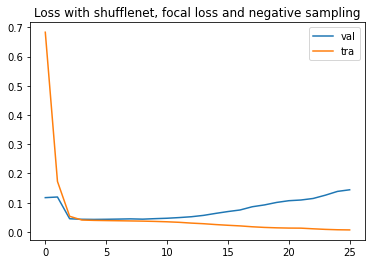

10 best predictions of the model


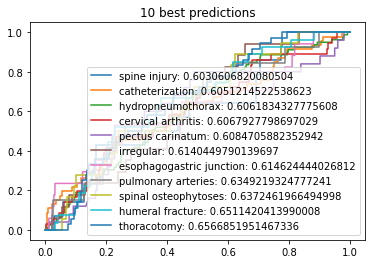

10 worst predictions of the model


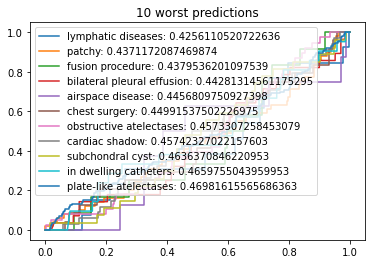

Score vs Number of samples


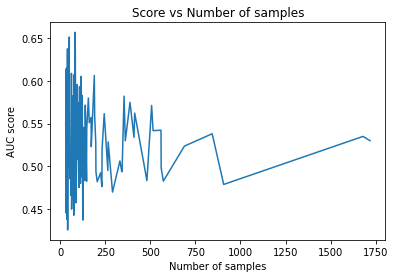


DECAYING learning rate.
The new learning rate is 0.000800


DECAYING learning rate.
The new learning rate is 0.000640


DECAYING learning rate.
The new learning rate is 0.000512

Model name: CNN with shufflenet, focal loss and no negative sampling
Test set performance
Precision 0.12627968337730872 Recall 0.12627968337730872 Overall Precision 0.04300975891854594 Overall Recall 0.04300975891854594 Macro F1 0.003467029930218582
Micro F1 0.17102630074328187 Instance F1 0.1581419194666145 Hamming loss 0.0956381926121372 AUC 0.5328263240653657
Training time 3417.132628440857


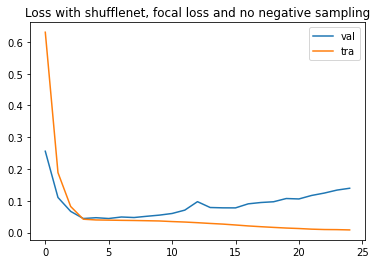

10 best predictions of the model


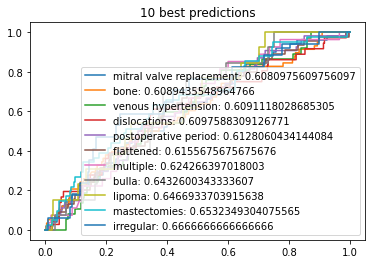

10 worst predictions of the model


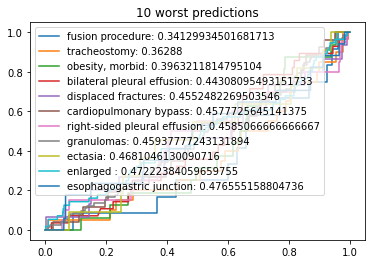

Score vs Number of samples


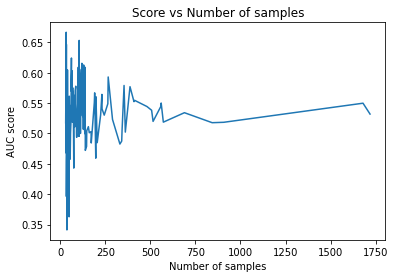


DECAYING learning rate.
The new learning rate is 0.000800


DECAYING learning rate.
The new learning rate is 0.000640


DECAYING learning rate.
The new learning rate is 0.000512

Model name: CNN with shufflenet, bce loss and negative sampling
Test set performance
Precision 0.12480211081794196 Recall 0.12480211081794196 Overall Precision 0.04435887316753434 Overall Recall 0.04435887316753434 Macro F1 0.0036197740909423
Micro F1 0.1690251572327044 Instance F1 0.15545312083054205 Hamming loss 0.09586906332453826 AUC 0.5250499680594851
Training time 3422.2579379081726


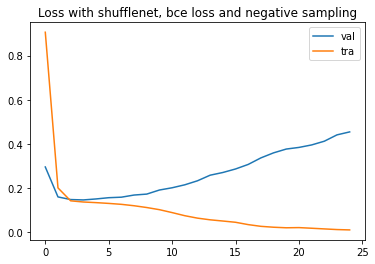

10 best predictions of the model


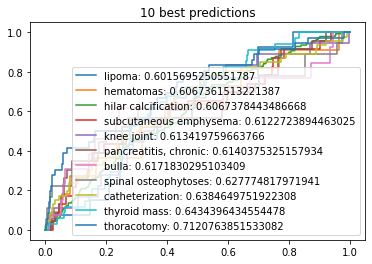

10 worst predictions of the model


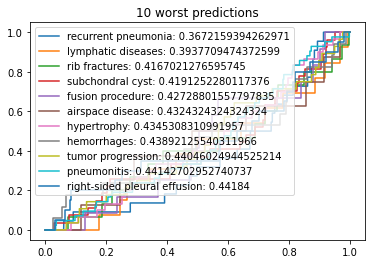

Score vs Number of samples


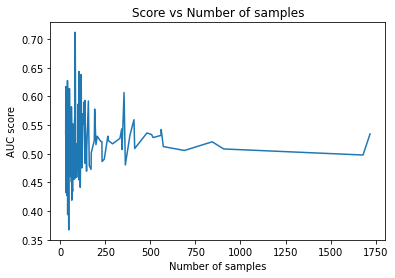


DECAYING learning rate.
The new learning rate is 0.000800


DECAYING learning rate.
The new learning rate is 0.000640


DECAYING learning rate.
The new learning rate is 0.000512

Model name: CNN with shufflenet, bce loss and no negative sampling
Test set performance
Precision 0.1279683377308707 Recall 0.1279683377308707 Overall Precision 0.042518895372295584 Overall Recall 0.042518895372295584 Macro F1 0.003580828657388641
Micro F1 0.17331332189822757 Instance F1 0.1608990476349797 Hamming loss 0.09537434036939314 AUC 0.5321718189775264
Training time 3412.2241904735565


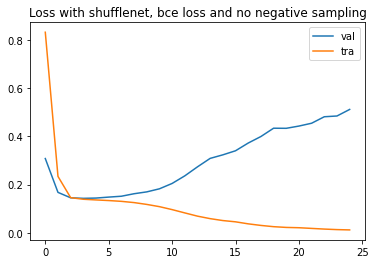

10 best predictions of the model


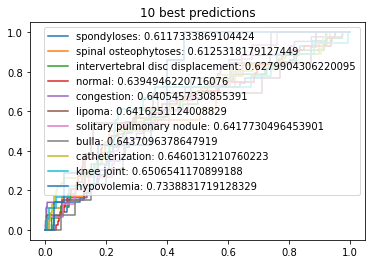

10 worst predictions of the model


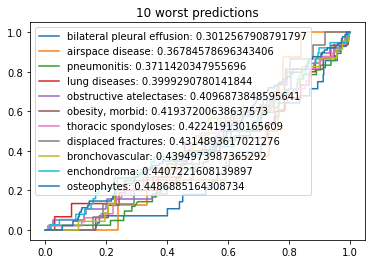

Score vs Number of samples


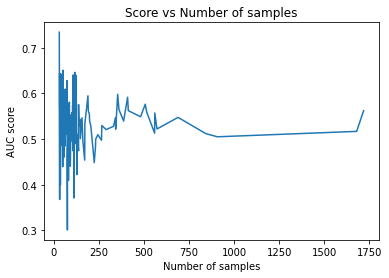

ValueError: ignored

In [0]:
import time 
import torch
from matplotlib import pyplot as plt

from models.mlc.cnn_mlc import CNNModel, train, prediction
from utils.constants import LR, epochs
from utils.utils import save_models, save_metrics, analyze_mistakes

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 

for ENCODER_NAME in ['shufflenet']:
  for loss_name in  losses_names:
    for USE_NEGATIVES in [True, False]:
      model = CNNModel(ENCODER_NAME, encoder_dim=encoder_encoderdim_mapping[ENCODER_NAME], UNIQUE_TAGS=UNIQUE_TAGS)
      model = model.to(device) 
      optimizer = torch.optim.Adam(model.parameters(), lr = LR)

      start = time.time()
      train_metrics, valid_metrics, test_metrics, model = train(0, epochs, train_set, valid_set, test_set, tag_to_index, UNIQUE_TAGS, model, optimizer,
          loss_name, device, USE_NEGATIVES, verbose=False)
      end = time.time()
      negative_samples_label = 'negative sampling'
      if not USE_NEGATIVES:
        negative_samples_label = 'no negative sampling'

      # print test set results
      print('=====================================================================================================')
      print(f'Model name: CNN with {ENCODER_NAME}, {loss_name} loss and {negative_samples_label}')
      pre, rec, ovpre, ovrec, macroF1, microF1, instanceF1, ham_loss, auc = test_metrics
      print('Test set performance')
      print(f'Precision {pre} Recall {rec} Overall Precision {ovpre} Overall Recall {ovrec} Macro F1 {macroF1}')
      print(f'Micro F1 {microF1} Instance F1 {instanceF1} Hamming loss {ham_loss} AUC {auc}')
      print(f'Training time {end-start}')

      # plot train results
      plt.plot(valid_metrics[:,0], label = 'val')
      plt.plot(train_metrics[:,0], label = 'tra')
      plt.title(f'Loss with {ENCODER_NAME}, {loss_name} loss and {negative_samples_label}')
      plt.legend()
      plt.show()

      # save to disk 
      save_models(f'{ENCODER_NAME} {loss_name}', USE_NEGATIVES, model=model)
      save_metrics(f'{ENCODER_NAME} {loss_name}', USE_NEGATIVES, train_metrics, valid_metrics, test_metrics)

      # mistakes analysis
      true, predicted, pred_scores = prediction(model, device, test_set, tag_to_index, UNIQUE_TAGS)
      _ = analyze_mistakes(true, predicted, pred_scores, train_set, tag_to_index, make_plots=True)

In [0]:
import numpy as np
from keras.models import Model
from keras.layers import Conv2D, Conv2DTranspose, Input
from keras.optimizers import Adam
import pickle

from preprocessing.preprocessing import image_normalization_mapping
from utils.constants import LR, IMG_SHAPE, EPOCHS
from utils.utils import batch_no_labels, showInRow, read_and_resize

"""
TO TRAIN AUTOENCODER RUN:
"""

class ConvolutionalAutoencoder():
    def __init__(self, IMAGES):
        self.X_train = IMAGES
        self.X_train_norm = image_normalization_mapping(IMAGES, 0,255,-1,1)
        self.autoencoder, self.dim_reducer = self.CreateAutoencoder(LR)

    def CreateAutoencoder(self, lr=0.001):
        input_img = Input(shape=IMG_SHAPE)
        l1 = Conv2D(filters=16, kernel_size=2, strides=(2, 2),
                    input_shape=IMG_SHAPE, activation='tanh')(input_img)
        l2 = Conv2D(filters=64, kernel_size=2, strides=(2, 2), activation='tanh')(l1)
        l3 = Conv2D(filters=128, kernel_size=2, strides=(2, 2), activation='tanh')(l2)
        l4 = Conv2D(filters=256, kernel_size=2, strides=(2, 2), activation='tanh')(l3)

        encoding = Conv2D(filters=128, kernel_size=2, strides=(2, 2))(l4)

        l5 = Conv2DTranspose(filters=512, kernel_size=2, strides=(2, 2), activation='tanh')(encoding)
        l6 = Conv2DTranspose(filters=256, kernel_size=2, strides=(2, 2), activation='tanh')(l5)
        l7 = Conv2DTranspose(filters=128, kernel_size=2, strides=(2, 2), activation='tanh')(l6)
        l8 = Conv2DTranspose(filters=128, kernel_size=2, strides=(2, 2), activation='tanh')(l7)

        decoded = Conv2DTranspose(filters=3, kernel_size=2, strides=(2, 2), activation='tanh')(l8)

        autoencoder = Model(inputs=input_img, outputs=decoded)
        optimizer = Adam(lr)
        autoencoder.compile(loss='mean_squared_error', optimizer=optimizer, metrics=['accuracy'])

        dim_reducer = Model(inputs=input_img, outputs=encoding)

        return autoencoder, dim_reducer

    def visualize(self):
        idx = np.random.randint(low=0, high=self.X_train.shape[0], size = 5)
        images = self.X_train_norm[idx]
        decoded_imgs = self.autoencoder.predict(images)
        img = image_normalization_mapping(decoded_imgs, -1, 1, 0, 255).astype('uint8')
        showInRow(images)
        showInRow(img)

    def train(self):
        for epoch in range(EPOCHS):
            n = 0
            LOSS, ACC = 0., 0.
            for data in batch_no_labels(self.X_train):
                loss, accuracy = self.autoencoder.train_on_batch(data, data)
                n += 1
                LOSS += loss
                ACC += accuracy
            LOSS /= n
            ACC /= n
            if epoch % 10 == 0:
                self.visualize()
                print(f'epoch {epoch} loss: {LOSS} accuracy: {ACC}')